In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

In [2]:
df= pd.read_csv("laptop_data.csv")
print(df.shape)
df

(1303, 12)


,Unnamed: 0,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price
0,0,Apple,Ultrabook,13.3,IPS Panel Retina Display 2560x1600,Intel Core i5 2.3GHz,8GB,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37kg,71378.6832
1,1,Apple,Ultrabook,13.3,1440x900,Intel Core i5 1.8GHz,8GB,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34kg,47895.5232
2,2,HP,Notebook,15.6,Full HD 1920x1080,Intel Core i5 7200U 2.5GHz,8GB,256GB SSD,Intel HD Graphics 620,No OS,1.86kg,30636.0000
3,3,Apple,Ultrabook,15.4,IPS Panel Retina Display 2880x1800,Intel Core i7 2.7GHz,16GB,512GB SSD,AMD Radeon Pro 455,macOS,1.83kg,135195.3360
4,4,Apple,Ultrabook,13.3,IPS Panel Retina Display 2560x1600,Intel Core i5 3.1GHz,8GB,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37kg,96095.8080
...,...,...,...,...,...,...,...,...,...,...,...,...
1298,1298,Lenovo,2 in 1 Convertible,14.0,IPS Panel Full HD / Touchscreen 1920x1080,Intel Core i7 6500U 2.5GHz,4GB,128GB SSD,Intel HD Graphics 520,Windows 10,1.8kg,33992.6400
1299,1299,Lenovo,2 in 1 Convertible,13.3,IPS Panel Quad HD+ / Touchscreen 3200x1800,Intel Core i7 6500U 2.5GHz,16GB,512GB SSD,Intel HD Graphics 520,Windows 10,1.3kg,79866.7200
1300,1300,Lenovo,Notebook,14.0,1366x768,Intel Celeron Dual Core N3050 1.6GHz,2GB,64GB Flash Storage,Intel HD Graphics,Windows 10,1.5kg,12201.1200
1301,1301,HP,Notebook,15.6,1366x768,Intel Core i7 6500U 2.5GHz,6GB,1TB HDD,AMD Radeon R5 M330,Windows 10,2.19kg,40705.9200


In [3]:
# check duplicates
df.duplicated().sum()

0

In [4]:
# check null values
df.isnull().sum()

Unnamed: 0          0
Company             0
TypeName            0
Inches              0
ScreenResolution    0
Cpu                 0
Ram                 0
Memory              0
Gpu                 0
OpSys               0
Weight              0
Price               0
dtype: int64

In [5]:
df.describe()

,Unnamed: 0,Inches,Price
count,1303.00000,1303.000000,1303.000000
mean,651.00000,15.017191,59870.042910
std,376.28801,1.426304,37243.201786
min,0.00000,10.100000,9270.720000
25%,325.50000,14.000000,31914.720000
50%,651.00000,15.600000,52054.560000
75%,976.50000,15.600000,79274.246400
max,1302.00000,18.400000,324954.720000


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1303 entries, 0 to 1302
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        1303 non-null   int64  
 1   Company           1303 non-null   object 
 2   TypeName          1303 non-null   object 
 3   Inches            1303 non-null   float64
 4   ScreenResolution  1303 non-null   object 
 5   Cpu               1303 non-null   object 
 6   Ram               1303 non-null   object 
 7   Memory            1303 non-null   object 
 8   Gpu               1303 non-null   object 
 9   OpSys             1303 non-null   object 
 10  Weight            1303 non-null   object 
 11  Price             1303 non-null   float64
dtypes: float64(2), int64(1), object(9)
memory usage: 122.3+ KB


In [7]:
# dropping the index row 
df.drop(columns=['Unnamed: 0'], inplace=True)
df.head()

,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price
0,Apple,Ultrabook,13.3,IPS Panel Retina Display 2560x1600,Intel Core i5 2.3GHz,8GB,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37kg,71378.6832
1,Apple,Ultrabook,13.3,1440x900,Intel Core i5 1.8GHz,8GB,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34kg,47895.5232
2,HP,Notebook,15.6,Full HD 1920x1080,Intel Core i5 7200U 2.5GHz,8GB,256GB SSD,Intel HD Graphics 620,No OS,1.86kg,30636.0000
3,Apple,Ultrabook,15.4,IPS Panel Retina Display 2880x1800,Intel Core i7 2.7GHz,16GB,512GB SSD,AMD Radeon Pro 455,macOS,1.83kg,135195.3360
4,Apple,Ultrabook,13.3,IPS Panel Retina Display 2560x1600,Intel Core i5 3.1GHz,8GB,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37kg,96095.8080


In [8]:
# preprocessing the ram and weight columns
df['Ram']= df['Ram'].str.replace('GB', '')
df['Weight']= df['Weight'].str.replace('kg', '')
df['Ram']= df['Ram'].astype('int32')
df['Weight']= df['Weight'].astype('float32')
df.head()

,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price
0,Apple,Ultrabook,13.3,IPS Panel Retina Display 2560x1600,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832
1,Apple,Ultrabook,13.3,1440x900,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232
2,HP,Notebook,15.6,Full HD 1920x1080,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000
3,Apple,Ultrabook,15.4,IPS Panel Retina Display 2880x1800,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360
4,Apple,Ultrabook,13.3,IPS Panel Retina Display 2560x1600,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1303 entries, 0 to 1302
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Company           1303 non-null   object 
 1   TypeName          1303 non-null   object 
 2   Inches            1303 non-null   float64
 3   ScreenResolution  1303 non-null   object 
 4   Cpu               1303 non-null   object 
 5   Ram               1303 non-null   int32  
 6   Memory            1303 non-null   object 
 7   Gpu               1303 non-null   object 
 8   OpSys             1303 non-null   object 
 9   Weight            1303 non-null   float32
 10  Price             1303 non-null   float64
dtypes: float32(1), float64(2), int32(1), object(7)
memory usage: 101.9+ KB


# EDA, DATA CLEANING AND PREPROCESSING

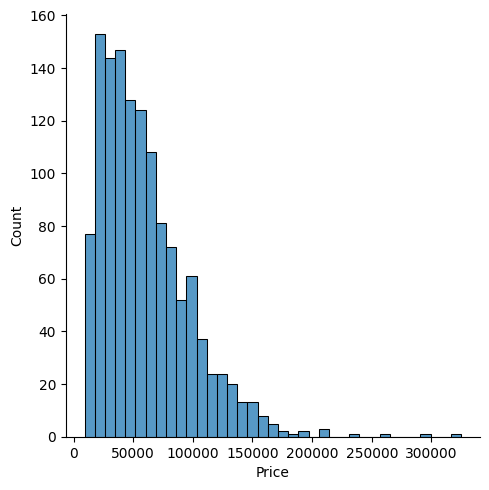

In [10]:
sns.displot(df['Price'])
plt.show()

Dell         297
Lenovo       297
HP           274
Asus         158
Acer         103
MSI           54
Toshiba       48
Apple         21
Samsung        9
Razer          7
Mediacom       7
Microsoft      6
Xiaomi         4
Vero           4
Chuwi          3
Google         3
Fujitsu        3
LG             3
Huawei         2
Name: Company, dtype: int64


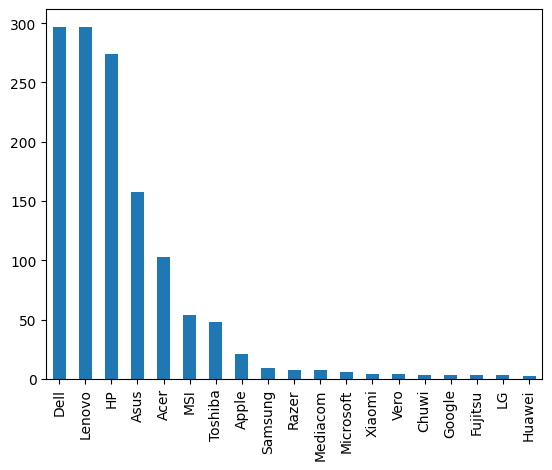

In [11]:
print(df['Company'].value_counts())
df['Company'].value_counts().plot(kind='bar')
plt.show()

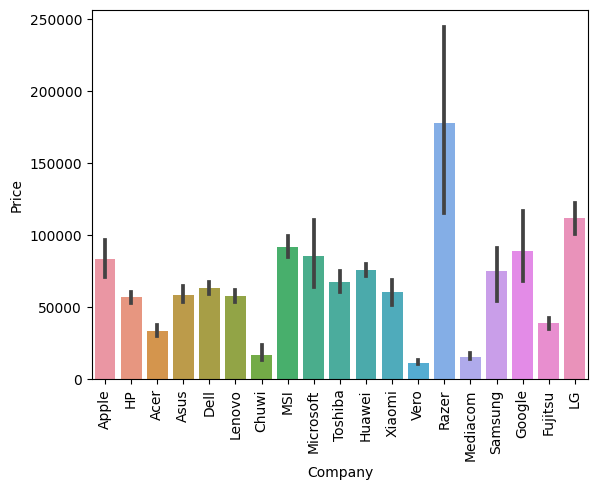

In [12]:
sns.barplot(x=df['Company'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

Notebook              727
Gaming                205
Ultrabook             196
2 in 1 Convertible    121
Workstation            29
Netbook                25
Name: TypeName, dtype: int64


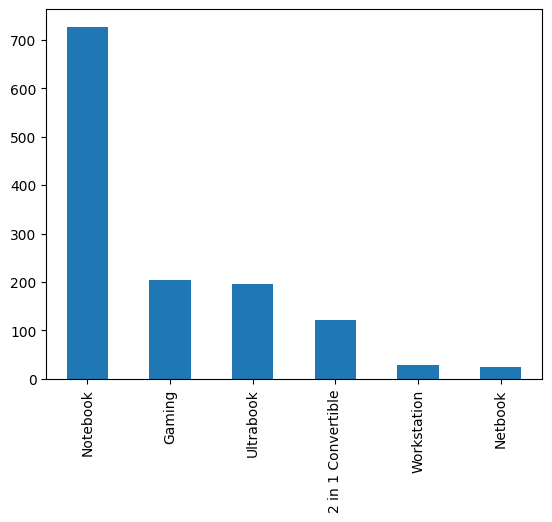

In [13]:
print(df['TypeName'].value_counts())
df['TypeName'].value_counts().plot(kind='bar')
plt.show()

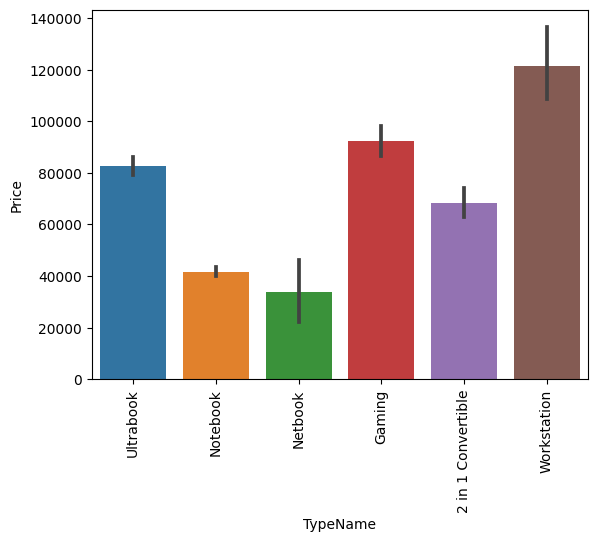

In [14]:
sns.barplot(x=df['TypeName'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

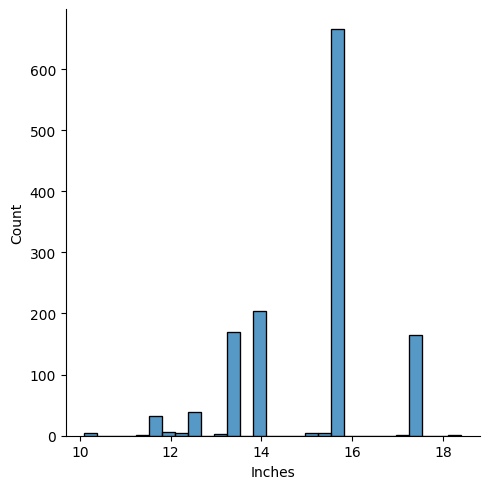

In [15]:
sns.displot(df['Inches'])
plt.show()

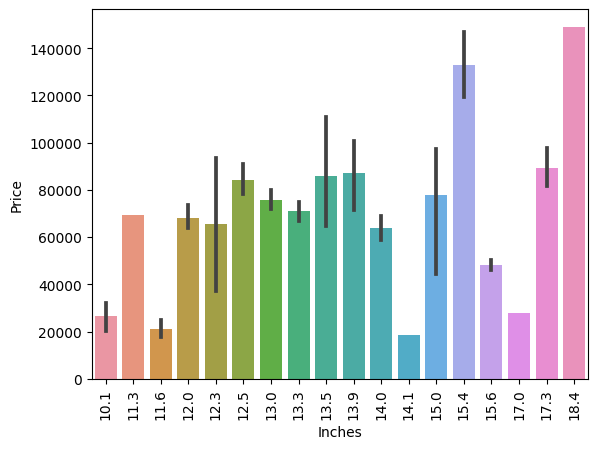

In [16]:
# here we can observe that there is not a very strong correlation but neverthless we can see
# that ssmaller screen size laptops have les price compared to laptops haoving bigger screens
sns.barplot(x=df['Inches'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

In [17]:
df['ScreenResolution'].value_counts()

Full HD 1920x1080                                507
1366x768                                         281
IPS Panel Full HD 1920x1080                      230
IPS Panel Full HD / Touchscreen 1920x1080         53
Full HD / Touchscreen 1920x1080                   47
1600x900                                          23
Touchscreen 1366x768                              16
Quad HD+ / Touchscreen 3200x1800                  15
IPS Panel 4K Ultra HD 3840x2160                   12
IPS Panel 4K Ultra HD / Touchscreen 3840x2160     11
4K Ultra HD / Touchscreen 3840x2160               10
4K Ultra HD 3840x2160                              7
Touchscreen 2560x1440                              7
IPS Panel 1366x768                                 7
IPS Panel Quad HD+ / Touchscreen 3200x1800         6
IPS Panel Retina Display 2560x1600                 6
IPS Panel Retina Display 2304x1440                 6
Touchscreen 2256x1504                              6
IPS Panel Touchscreen 2560x1440               

In [18]:
# now as we observe above there are laptops with touchscreen so lets make a feature 
df['Touchscreen']= df['ScreenResolution'].apply(lambda x:1 if 'Touchscreen' in str(x).split(" ") else 0)
df.sample(5)

,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen
1190,Lenovo,Gaming,15.6,IPS Panel Full HD 1920x1080,Intel Core i5 7300HQ 2.5GHz,8,1TB HDD,Nvidia GeForce GTX 1050,Windows 10,2.40,43636.32,0
577,Lenovo,Gaming,17.3,IPS Panel Full HD 1920x1080,Intel Core i7 6820HK 2.7GHz,32,256GB SSD + 1TB HDD,Nvidia GeForce GTX 1070,Windows 10,4.60,141884.64,0
603,MSI,Gaming,17.3,Full HD 1920x1080,Intel Core i7 6820HK 2.7GHz,16,128GB SSD + 1TB HDD,Nvidia GeForce GTX 970M,Windows 10,4.14,117162.72,0
1102,Acer,Notebook,15.6,1366x768,Intel Celeron Dual Core 3205U 1.5GHz,4,16GB SSD,Intel HD Graphics,Chrome OS,2.20,11135.52,0
578,MSI,Gaming,17.3,Full HD 1920x1080,Intel Core i7 7820HK 2.9GHz,16,512GB SSD + 1TB HDD,Nvidia GeForce GTX 1070,Windows 10,4.14,145401.12,0


0    1111
1     192
Name: Touchscreen, dtype: int64


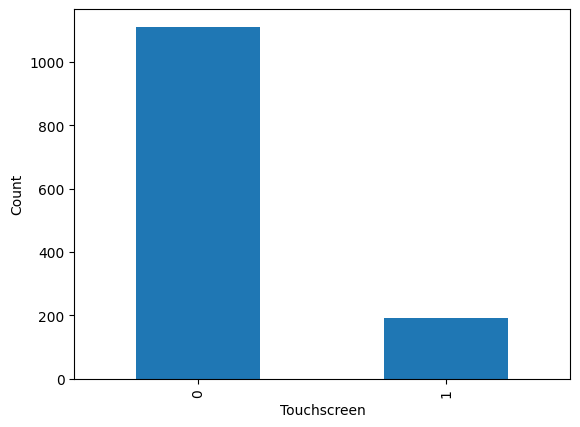

In [19]:
print(df['Touchscreen'].value_counts())
df['Touchscreen'].value_counts().plot(kind="bar") 
plt.xlabel('Touchscreen')
plt.ylabel('Count')
plt.show()

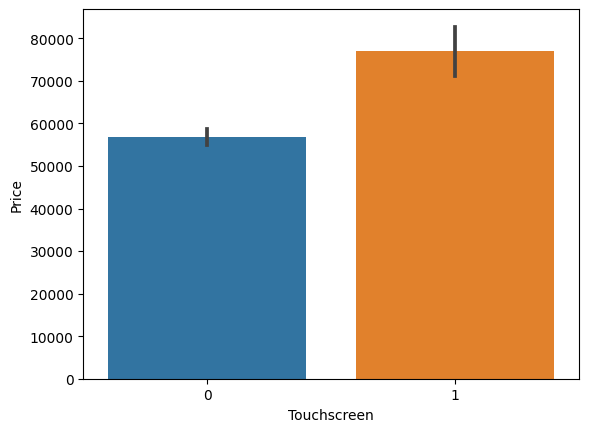

In [20]:
# we can clearly observe that the touchscreeen laptops have more price than non touchscreeen laptops
sns.barplot(x=df['Touchscreen'], y=df['Price'])

plt.show()

In [21]:
df['IPS']= df['ScreenResolution'].apply(lambda x:1 if 'IPS' in str(x).split(" ") else 0)
df.sample(5)

,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS
148,MSI,Gaming,17.3,Full HD 1920x1080,Intel Core i7 7700HQ 2.8GHz,16,256GB SSD + 1TB HDD,Nvidia GeForce GTX 1070,Windows 10,2.90,108105.1200,0,0
354,Toshiba,Notebook,15.6,IPS Panel Full HD 1920x1080,Intel Core i7 6500U 2.5GHz,16,512GB SSD,Nvidia GeForce 930M,Windows 10,2.40,74751.8400,0,1
843,Dell,Notebook,15.6,1366x768,Intel Core i5 7200U 2.5GHz,8,128GB SSD,Intel HD Graphics 620,Windows 10,2.18,38041.3872,0,0
1187,Acer,Notebook,15.6,Full HD 1920x1080,Intel Core i5 7200U 2.5GHz,4,256GB SSD,Nvidia GeForce 940MX,Windows 10,2.23,36816.4800,0,0
735,Lenovo,Notebook,15.6,Full HD 1920x1080,Intel Core i7 7500U 2.7GHz,4,1TB HDD,Intel HD Graphics 620,Windows 10,1.85,41505.1200,0,0


0    938
1    365
Name: IPS, dtype: int64


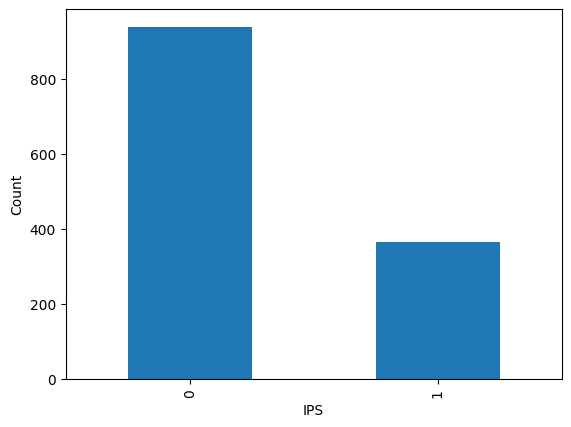

In [22]:
# figuring out which laptops have ips panel
print(df['IPS'].value_counts())
df['IPS'].value_counts().plot(kind="bar")
plt.xlabel('IPS')
plt.ylabel('Count')
plt.show()

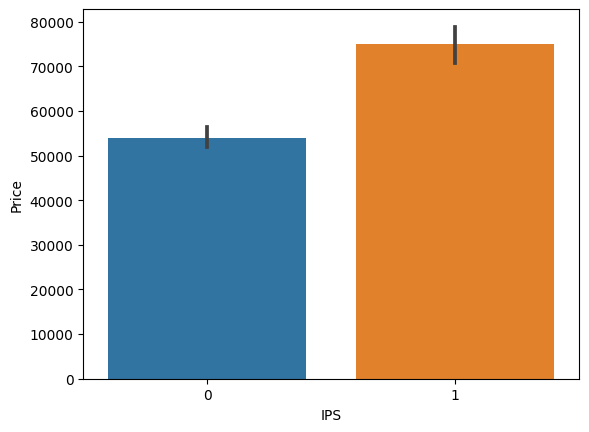

In [23]:
# we can clearly observe that the IPS panel laptops have more price than non touchscreeen laptops
sns.barplot(x=df['IPS'], y=df['Price'])
plt.show()

In [24]:
df['Res_width']= df['ScreenResolution'].apply(lambda x:str(x).split(" ")[-1].split("x")[0])
df['Res_height']= df['ScreenResolution'].apply(lambda x:str(x).split(" ")[-1].split("x")[1])
df['Res_width']= df['Res_width'].astype('int32')
df['Res_height']= df['Res_height'].astype('int32')
print(df.shape)
df.sample(5)

(1303, 15)


,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height
1209,Asus,Gaming,15.6,Full HD 1920x1080,Intel Core i7 7700HQ 2.8GHz,16,256GB SSD + 1TB HDD,Nvidia GeForce GTX 1070,Windows 10,2.20,130482.72,0,0,1920,1080
107,Asus,Ultrabook,14.0,IPS Panel Full HD 1920x1080,Intel Core i7 7500U 2.7GHz,8,256GB SSD,Nvidia GeForce 940MX,Windows 10,1.30,63563.04,0,1,1920,1080
978,HP,Notebook,15.6,1366x768,Intel Core i7 7500U 2.7GHz,6,1TB HDD,Intel HD Graphics 620,Windows 10,2.04,30849.12,0,0,1366,768
487,Dell,Notebook,15.6,Full HD 1920x1080,Intel Core i7 7700HQ 2.8GHz,16,512GB SSD,Nvidia GeForce GTX 1050,Windows 10,2.06,101178.72,0,0,1920,1080
60,Dell,Notebook,17.3,Full HD 1920x1080,Intel Core i7 8550U 1.8GHz,16,256GB SSD + 2TB HDD,AMD Radeon 530,Windows 10,2.80,69210.72,0,0,1920,1080


In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1303 entries, 0 to 1302
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Company           1303 non-null   object 
 1   TypeName          1303 non-null   object 
 2   Inches            1303 non-null   float64
 3   ScreenResolution  1303 non-null   object 
 4   Cpu               1303 non-null   object 
 5   Ram               1303 non-null   int32  
 6   Memory            1303 non-null   object 
 7   Gpu               1303 non-null   object 
 8   OpSys             1303 non-null   object 
 9   Weight            1303 non-null   float32
 10  Price             1303 non-null   float64
 11  Touchscreen       1303 non-null   int64  
 12  IPS               1303 non-null   int64  
 13  Res_width         1303 non-null   int32  
 14  Res_height        1303 non-null   int32  
dtypes: float32(1), float64(2), int32(3), int64(2), object(7)
memory usage: 132.5+ KB


In [26]:
# making a new feature for ppi (pixel per inches)
def ppi(width, height, inches):
    return np.round((width**2 + height**2)**0.5 / inches) 

In [27]:
df['PPI']= ppi(df['Res_width'], df['Res_height'], df['Inches'])
df['PPI']= df['PPI'].astype('int')
print(df.shape)
df.sample(5)

(1303, 16)


,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI
313,Acer,Notebook,15.6,Full HD 1920x1080,AMD A8-Series 7410 2.2GHz,8,256GB SSD,AMD Radeon R5,Windows 10,2.23,24988.32,0,0,1920,1080,141
973,Toshiba,Notebook,14.0,Full HD 1920x1080,Intel Core i5 6200U 2.3GHz,8,256GB SSD,Intel HD Graphics 520,Windows 10,1.95,62870.40,0,0,1920,1080,157
110,Asus,Ultrabook,15.6,Full HD 1920x1080,Intel Core i7 8550U 1.8GHz,16,256GB SSD + 1TB HDD,Nvidia GeForce MX150,Windows 10,1.50,67239.36,0,0,1920,1080,141
1250,Dell,Notebook,15.6,1366x768,Intel Pentium Quad Core N3710 1.6GHz,4,500GB HDD,Intel HD Graphics,Linux,2.20,17262.72,0,0,1366,768,100
299,Asus,Ultrabook,15.6,Full HD 1920x1080,Intel Core i7 7500U 2.7GHz,16,512GB SSD,Nvidia GeForce 940MX,Windows 10,1.63,78215.04,0,0,1920,1080,141


In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1303 entries, 0 to 1302
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Company           1303 non-null   object 
 1   TypeName          1303 non-null   object 
 2   Inches            1303 non-null   float64
 3   ScreenResolution  1303 non-null   object 
 4   Cpu               1303 non-null   object 
 5   Ram               1303 non-null   int32  
 6   Memory            1303 non-null   object 
 7   Gpu               1303 non-null   object 
 8   OpSys             1303 non-null   object 
 9   Weight            1303 non-null   float32
 10  Price             1303 non-null   float64
 11  Touchscreen       1303 non-null   int64  
 12  IPS               1303 non-null   int64  
 13  Res_width         1303 non-null   int32  
 14  Res_height        1303 non-null   int32  
 15  PPI               1303 non-null   int64  
dtypes: float32(1), float64(2), int32(3), int64

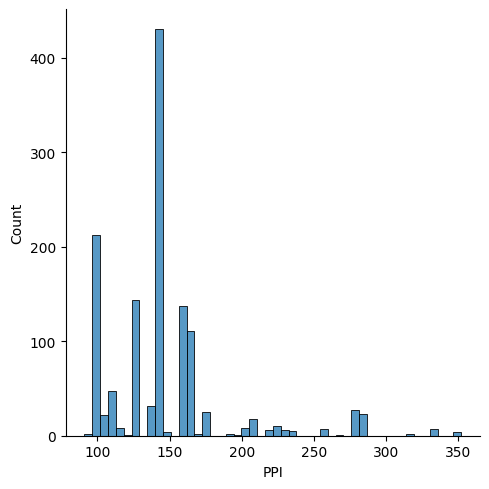

In [29]:
sns.displot(df['PPI'])
plt.show()

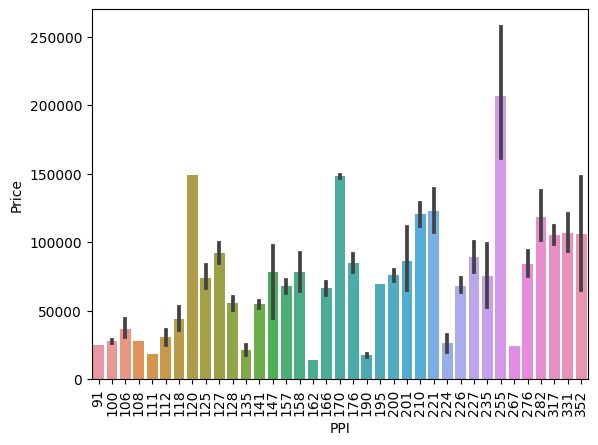

In [30]:
sns.barplot(x= df['PPI'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

In [31]:
df['Retina']= df['ScreenResolution'].apply(lambda x:1 if 'Retina' in str(x).split(" ") else 0)
df.sample(5)

,Company,TypeName,Inches,ScreenResolution,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina
1044,HP,Notebook,14.0,Full HD 1920x1080,Intel Core i5 6200U 2.3GHz,4,500GB HDD,Intel HD Graphics 520,Windows 10,1.54,53280.00,0,0,1920,1080,157,0
298,Lenovo,Notebook,15.6,Full HD 1920x1080,AMD A10-Series 9600P 2.4GHz,6,1TB HDD,AMD Radeon R5 430,Windows 10,2.40,26586.72,0,0,1920,1080,141,0
626,Mediacom,Notebook,14.0,Full HD 1920x1080,Intel Atom x5-Z8350 1.44GHz,2,32GB Flash Storage,Intel HD Graphics,Windows 10,1.40,12733.92,0,0,1920,1080,157,0
1081,Lenovo,Gaming,17.3,IPS Panel Full HD 1920x1080,Intel Core i7 6820HK 2.7GHz,32,512GB SSD + 1.0TB Hybrid,Nvidia GeForce GTX 980M,Windows 10,4.60,172627.20,0,1,1920,1080,127,0
89,Dell,Ultrabook,13.3,IPS Panel Full HD 1920x1080,Intel Core i7 8550U 1.8GHz,8,256GB SSD,Intel UHD Graphics 620,Windows 10,1.21,87858.72,0,1,1920,1080,166,0


0    1286
1      17
Name: Retina, dtype: int64


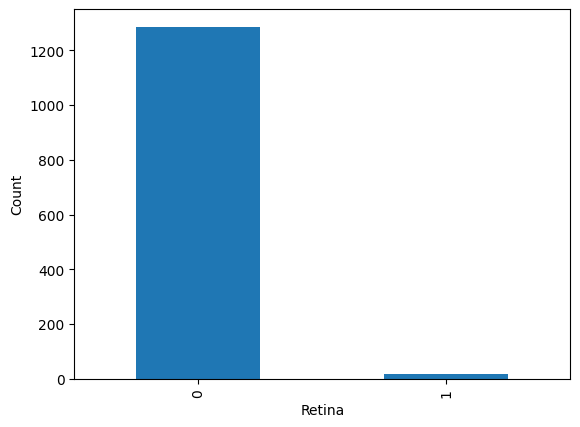

In [32]:
print(df['Retina'].value_counts())
df['Retina'].value_counts().plot(kind="bar")
plt.xlabel('Retina')
plt.ylabel('Count')
plt.show()

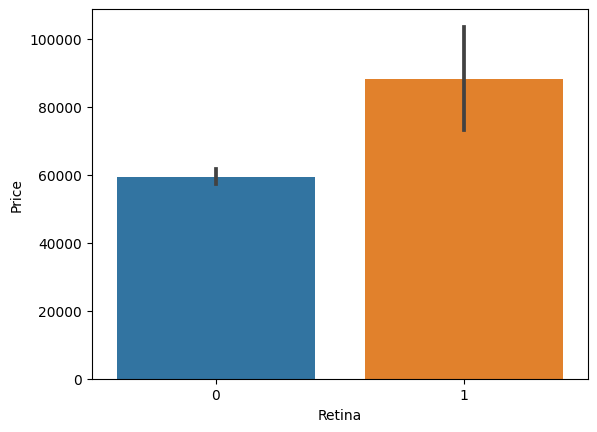

In [33]:
# we can clearly observe that retina display laptops has high price as they belong to apple 
sns.barplot(x=df['Retina'], y=df['Price'])
plt.show()

In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1303 entries, 0 to 1302
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Company           1303 non-null   object 
 1   TypeName          1303 non-null   object 
 2   Inches            1303 non-null   float64
 3   ScreenResolution  1303 non-null   object 
 4   Cpu               1303 non-null   object 
 5   Ram               1303 non-null   int32  
 6   Memory            1303 non-null   object 
 7   Gpu               1303 non-null   object 
 8   OpSys             1303 non-null   object 
 9   Weight            1303 non-null   float32
 10  Price             1303 non-null   float64
 11  Touchscreen       1303 non-null   int64  
 12  IPS               1303 non-null   int64  
 13  Res_width         1303 non-null   int32  
 14  Res_height        1303 non-null   int32  
 15  PPI               1303 non-null   int64  
 16  Retina            1303 non-null   int64  


In [35]:
# now we have processed the screenresolution column lets drop that column
df.drop(columns=['ScreenResolution'], inplace=True)

In [36]:
df.head()

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina
0,Apple,Ultrabook,13.3,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1
1,Apple,Ultrabook,13.3,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0
2,HP,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0
3,Apple,Ultrabook,15.4,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1
4,Apple,Ultrabook,13.3,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1


In [37]:
# now lets handle the cpu 
df['Cpu'].value_counts()

Intel Core i5 7200U 2.5GHz       190
Intel Core i7 7700HQ 2.8GHz      146
Intel Core i7 7500U 2.7GHz       134
Intel Core i7 8550U 1.8GHz        73
Intel Core i5 8250U 1.6GHz        72
                                ... 
Intel Core M M3-6Y30 0.9GHz        1
AMD A9-Series 9420 2.9GHz          1
Intel Core i3 6006U 2.2GHz         1
AMD A6-Series 7310 2GHz            1
Intel Xeon E3-1535M v6 3.1GHz      1
Name: Cpu, Length: 118, dtype: int64

In [38]:
df['Cpu'].apply(lambda x:str(x).split(" ")[:3]).value_counts()

[Intel, Core, i7]               527
[Intel, Core, i5]               423
[Intel, Core, i3]               136
[Intel, Celeron, Dual]           80
[Intel, Pentium, Quad]           27
[Intel, Core, M]                 19
[AMD, A9-Series, 9420]           12
[Intel, Celeron, Quad]            8
[AMD, A6-Series, 9220]            8
[AMD, A12-Series, 9720P]          7
[Intel, Atom, x5-Z8350]           5
[AMD, A8-Series, 7410]            4
[Intel, Atom, x5-Z8550]           4
[Intel, Pentium, Dual]            3
[AMD, A9-Series, 9410]            3
[AMD, Ryzen, 1700]                3
[AMD, A9-Series, A9-9420]         2
[AMD, A10-Series, 9620P]          2
[Intel, Atom, X5-Z8350]           2
[AMD, E-Series, E2-9000e]         2
[Intel, Xeon, E3-1535M]           2
[Intel, Xeon, E3-1505M]           2
[AMD, E-Series, 7110]             2
[AMD, A10-Series, 9600P]          2
[AMD, A6-Series, A6-9220]         2
[AMD, A10-Series, A10-9620P]      2
[AMD, Ryzen, 1600]                1
[Intel, Atom, x5-Z8300]     

In [39]:
df['Cpu_brand']= df['Cpu'].apply(lambda x:"".join(str(x).split(" ")[0]))
df.head()

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand
0,Apple,Ultrabook,13.3,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel
1,Apple,Ultrabook,13.3,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel
2,HP,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel
3,Apple,Ultrabook,15.4,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel
4,Apple,Ultrabook,13.3,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel


Intel      1240
AMD          62
Samsung       1
Name: Cpu_brand, dtype: int64


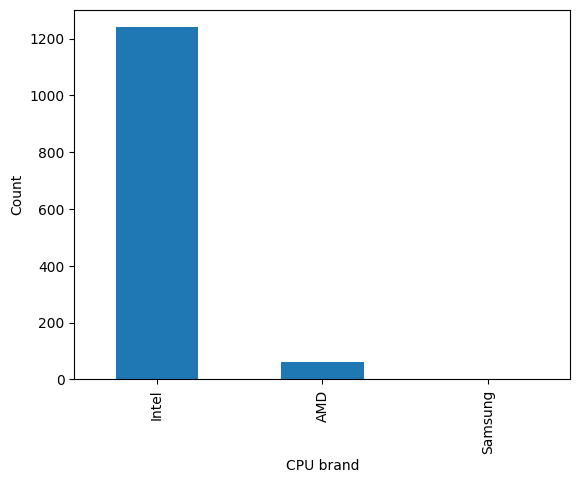

In [40]:
print(df['Cpu_brand'].value_counts())
df['Cpu_brand'].value_counts().plot(kind="bar")
plt.xlabel('CPU brand')
plt.ylabel('Count')
plt.show()

In [41]:
df[df['Cpu_brand']=='Samsung']

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand
1191,Samsung,2 in 1 Convertible,12.3,Samsung Cortex A72&A53 2.0GHz,4,32GB Flash Storage,ARM Mali T860 MP4,Chrome OS,1.15,35111.52,1,1,2400,1600,235,0,Samsung


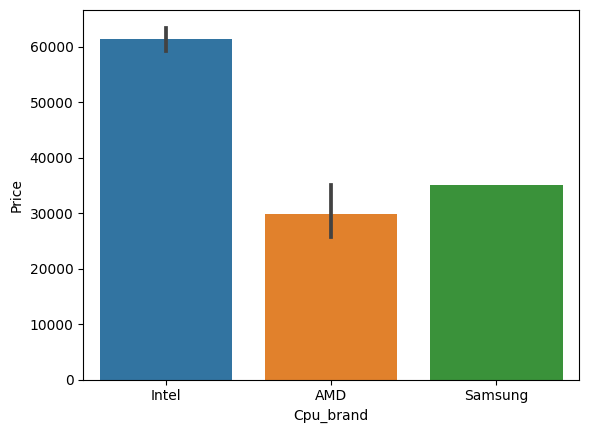

In [42]:
# we can observe that Intel CPU laptops have generally higher costs than AMD laptops
# and there is only one laptop with samsung processor
sns.barplot(x=df['Cpu_brand'], y=df['Price'])
plt.show()

In [43]:
# here we observe that there is only one laptop with samsung cpu which does not hep so we remove it
df= df[df['Cpu_brand']!="Samsung"]
print(df.shape)
df.head()

(1302, 17)


,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand
0,Apple,Ultrabook,13.3,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel
1,Apple,Ultrabook,13.3,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel
2,HP,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel
3,Apple,Ultrabook,15.4,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel
4,Apple,Ultrabook,13.3,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel


In [44]:
df['Cpu_name']= df['Cpu'].apply(lambda x:" ".join(str(x).split(" ")[0:3]))
df.head()

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand,Cpu_name
0,Apple,Ultrabook,13.3,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel,Intel Core i5
1,Apple,Ultrabook,13.3,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel,Intel Core i5
2,HP,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel,Intel Core i5
3,Apple,Ultrabook,15.4,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel,Intel Core i7
4,Apple,Ultrabook,13.3,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel,Intel Core i5


In [45]:
def fetch_cpu_type(text):
    text_list=text.split(" ")
    if text_list[0]=="Intel":
        return " ".join(text_list[:-1])
    elif text_list[0]=="AMD" and text_list[1][0]=="A":
        return "AMD A-Series"
    elif text_list[0]=="AMD":
        return " ".join(text_list[:-1])
    elif text_list[0]=="Samsung":
        return " ".join(text_list[:-1])

In [46]:
df['Cpu_type']= df['Cpu_name'].apply(fetch_cpu_type)
df.sample(5)

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand,Cpu_name,Cpu_type
342,HP,Notebook,15.6,Intel Core i3 7100U 2.4GHz,8,1TB HDD,Nvidia GeForce 930MX,Windows 10,2.10,38148.48,0,1,1920,1080,141,0,Intel,Intel Core i3,Intel Core
93,Dell,Gaming,15.6,Intel Core i5 7300HQ 2.5GHz,8,256GB SSD,Nvidia GeForce GTX 1060,Windows 10,2.65,63669.60,0,0,1920,1080,141,0,Intel,Intel Core i5,Intel Core
565,Dell,Ultrabook,13.3,Intel Core i5 8250U 1.6GHz,8,128GB SSD,Intel UHD Graphics 620,Windows 10,1.21,85194.72,1,1,3840,2160,331,0,Intel,Intel Core i5,Intel Core
1108,HP,Notebook,15.6,AMD A6-Series 9220 2.5GHz,4,1TB HDD,AMD Radeon R4,Windows 10,2.10,21205.44,0,0,1920,1080,141,0,AMD,AMD A6-Series 9220,AMD A-Series
704,Lenovo,Notebook,15.6,Intel Core i3 6006U 2GHz,4,500GB HDD,Intel HD Graphics 520,No OS,1.90,23976.00,0,0,1366,768,100,0,Intel,Intel Core i3,Intel Core


Intel Core       1105
Intel Celeron      88
AMD A-Series       47
Intel Pentium      30
Intel Atom         13
AMD E-Series        9
AMD Ryzen           4
Intel Xeon          4
AMD FX              2
Name: Cpu_type, dtype: int64


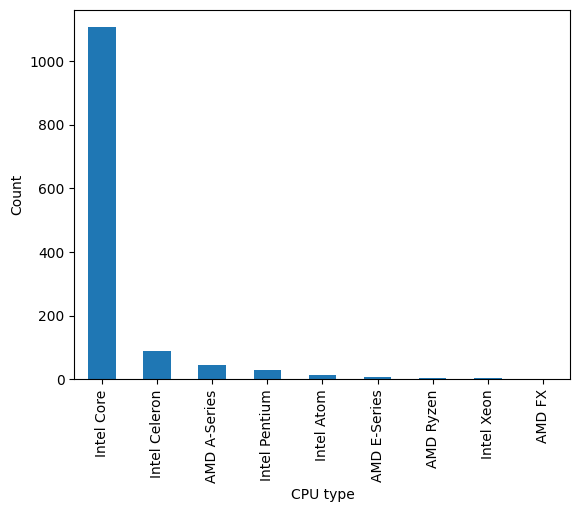

In [47]:
print(df['Cpu_type'].value_counts())
df['Cpu_type'].value_counts().plot(kind="bar")
plt.xlabel('CPU type')
plt.ylabel('Count')
plt.show()

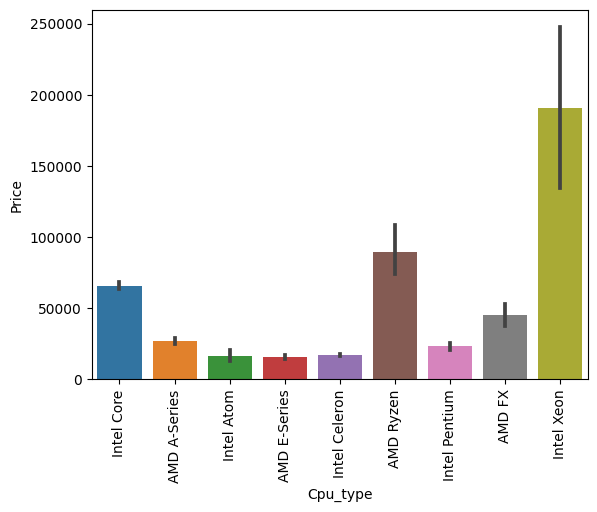

In [48]:
sns.barplot(x=df['Cpu_type'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

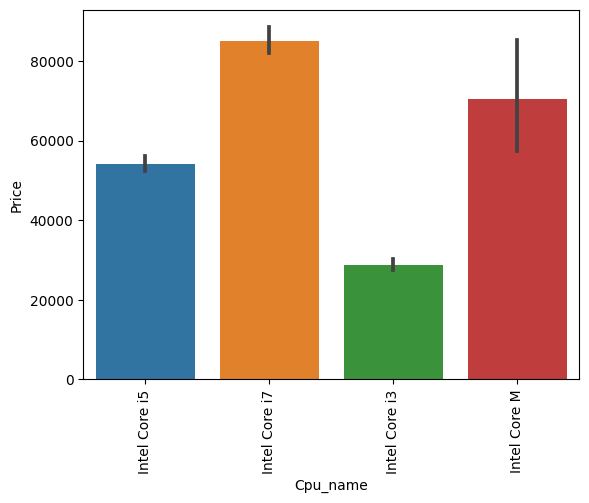

In [49]:
x= sns.barplot(x= df['Cpu_name'][df['Cpu_type']=='Intel Core'], y= df['Price'][df['Cpu_type']=='Intel Core'])
plt.xticks(rotation=90)
plt.show()

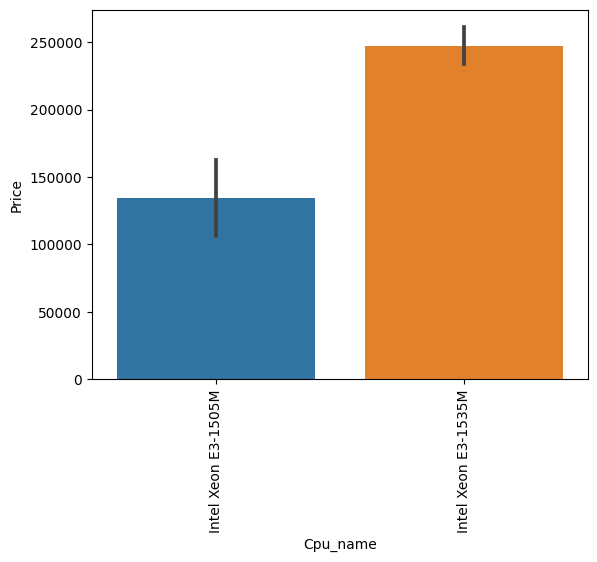

In [50]:
x= sns.barplot(x= df['Cpu_name'][df['Cpu_type']=='Intel Xeon'], y= df['Price'][df['Cpu_type']=='Intel Xeon'])
plt.xticks(rotation=90)
plt.show()

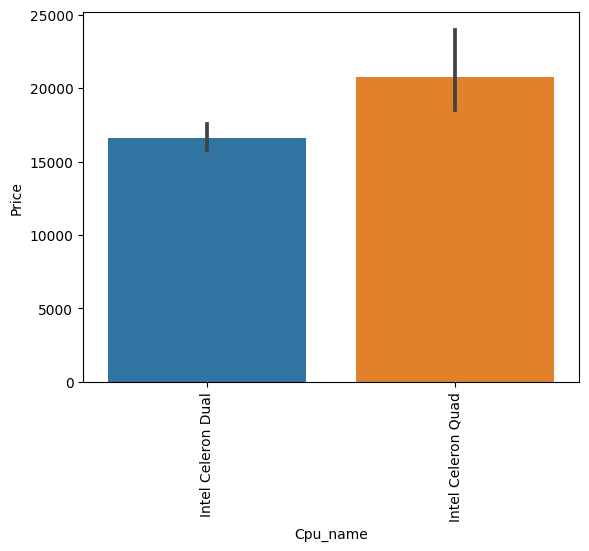

In [51]:
x= sns.barplot(x= df['Cpu_name'][df['Cpu_type']=='Intel Celeron'], y= df['Price'][df['Cpu_type']=='Intel Celeron'])
plt.xticks(rotation=90)
plt.show()

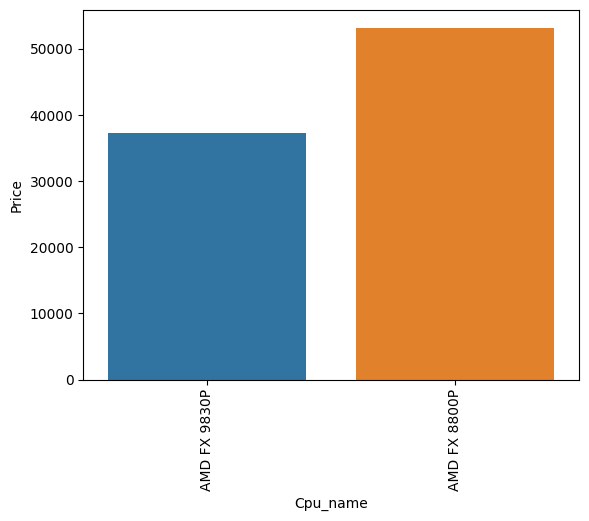

In [52]:
x= sns.barplot(x= df['Cpu_name'][df['Cpu_type']=='AMD FX'], y= df['Price'][df['Cpu_type']=='AMD FX'])
plt.xticks(rotation=90)
plt.show()

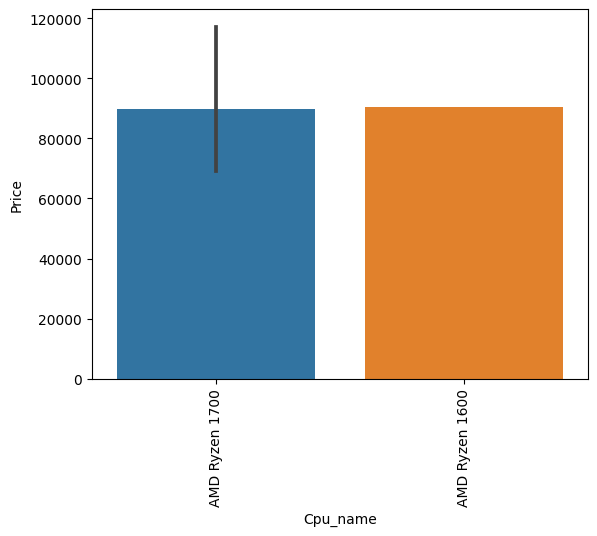

In [53]:
x= sns.barplot(x= df['Cpu_name'][df['Cpu_type']=='AMD Ryzen'], y= df['Price'][df['Cpu_type']=='AMD Ryzen'])
plt.xticks(rotation=90)
plt.show()

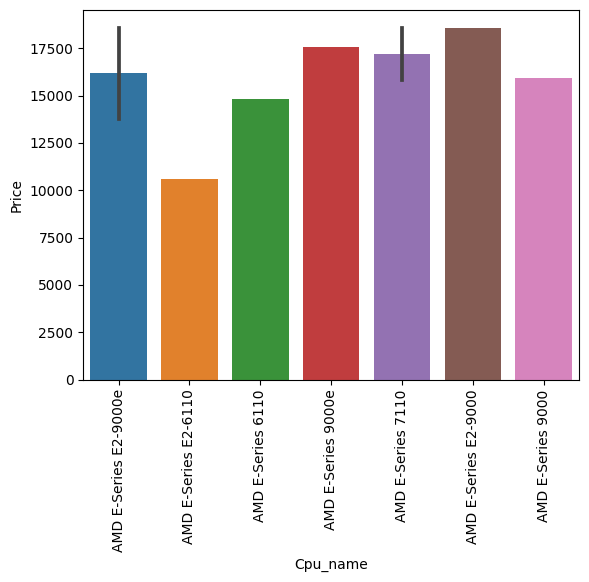

In [54]:
x= sns.barplot(x= df['Cpu_name'][df['Cpu_type']=='AMD E-Series'], y= df['Price'][df['Cpu_type']=='AMD E-Series'])
plt.xticks(rotation=90)
plt.show()

In [55]:
# fom the above plot we notice that Intel Xeon is the most costly processor
# so lets keep categories like intel core (i3, i5, i7, M), Intel xeon, other Intel 
# AMD Ryzen, other AMD
# Samsung processors are combined with AMD processors as they have the same price range

In [56]:
def fetch_cpu_name(text):
    text_list=text.split(" ")
    if text=="Intel Core i3" or text=="Intel Core i5" or text=="Intel Core i7" or text=="Intel Core M":
        return text
    elif text_list[1]=="Xeon":
        return "Intel Xeon"
    elif text_list[1]=="Ryzen":
        return "AMD Ryzen"
    elif text_list[0]=="Intel":
        return "other Intel processors"
    else:
        return "other AMD processors"

In [57]:
df['Cpu_name']= df["Cpu_name"].apply(fetch_cpu_name)
df.head(5)

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand,Cpu_name,Cpu_type
0,Apple,Ultrabook,13.3,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel,Intel Core i5,Intel Core
1,Apple,Ultrabook,13.3,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel,Intel Core i5,Intel Core
2,HP,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel,Intel Core i5,Intel Core
3,Apple,Ultrabook,15.4,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel,Intel Core i7,Intel Core
4,Apple,Ultrabook,13.3,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel,Intel Core i5,Intel Core


Intel Core i7             527
Intel Core i5             423
Intel Core i3             136
other Intel processors    131
other AMD processors       58
Intel Core M               19
AMD Ryzen                   4
Intel Xeon                  4
Name: Cpu_name, dtype: int64


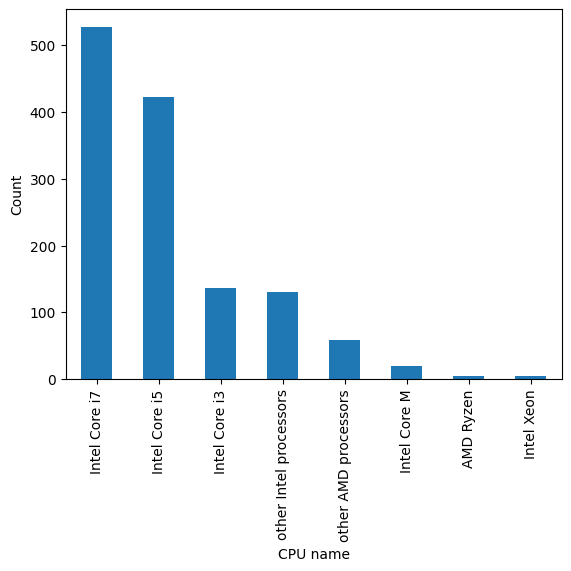

In [58]:
print(df['Cpu_name'].value_counts())
df['Cpu_name'].value_counts().plot(kind="bar")
plt.xlabel('CPU name')
plt.ylabel('Count')
plt.show()

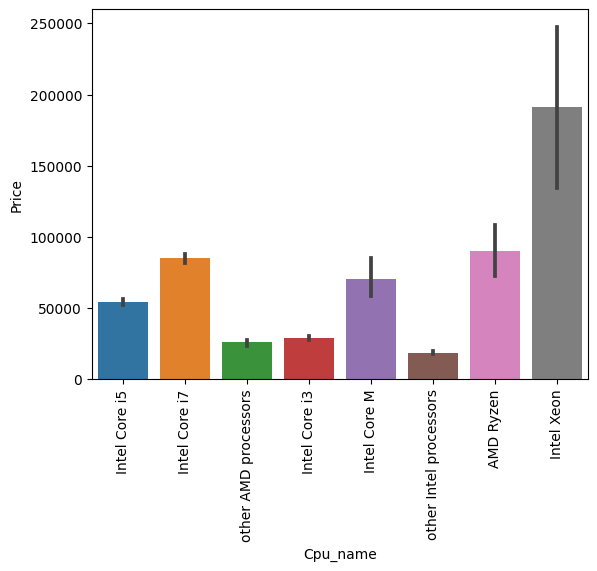

In [59]:
sns.barplot(x=df['Cpu_name'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

In [60]:
df.sample(5)

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_brand,Cpu_name,Cpu_type
933,Lenovo,2 in 1 Convertible,13.3,Intel Core i7 6560U 2.2GHz,16,1TB SSD,Intel Iris Graphics 540,Windows 10,1.30,95850.7200,1,1,3200,1800,276,0,Intel,Intel Core i7,Intel Core
516,HP,Notebook,15.6,Intel Core i5 8250U 1.6GHz,4,1TB HDD,Intel UHD Graphics 620,Windows 10,2.04,27783.9216,1,0,1366,768,100,0,Intel,Intel Core i5,Intel Core
468,HP,Gaming,17.3,Intel Core i7 7700HQ 2.8GHz,12,1TB HDD,Nvidia GeForce GTX 1060,Windows 10,3.78,90522.7200,0,1,1920,1080,127,0,Intel,Intel Core i7,Intel Core
41,Dell,Gaming,15.6,Intel Core i7 7700HQ 2.8GHz,16,256GB SSD + 1TB HDD,Nvidia GeForce GTX 1060,Windows 10,2.65,79866.7200,0,1,1920,1080,141,0,Intel,Intel Core i7,Intel Core
1063,Dell,Notebook,15.6,Intel Core i7 7500U 2.7GHz,16,2TB HDD,AMD Radeon R7 M445,Windows 10,2.32,52746.6672,0,0,1920,1080,141,0,Intel,Intel Core i7,Intel Core


In [61]:
# Finally drop other cpu columns and only keep cpu_name column
df.drop(columns=['Cpu_brand', 'Cpu_type'], inplace=True)
df.sample(5)

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_name
988,Dell,Notebook,15.6,Intel Core i7 7500U 2.7GHz,8,1TB HDD,AMD Radeon R7 M445,Windows 10,2.36,39906.72,0,0,1366,768,100,0,Intel Core i7
222,Toshiba,Ultrabook,13.3,Intel Core i7 6500U 2.5GHz,8,256GB SSD,Intel HD Graphics 520,Windows 10,1.20,72620.64,0,0,1920,1080,166,0,Intel Core i7
905,LG,Ultrabook,15.6,Intel Core i7 7500U 2.7GHz,16,512GB SSD,Intel HD Graphics 620,Windows 10,1.08,111834.72,1,1,1920,1080,141,0,Intel Core i7
647,Razer,Gaming,14.0,Intel Core i7 7700HQ 2.8GHz,16,256GB SSD,Nvidia GeForce GTX 1060,Windows 10,1.95,138474.72,0,0,1920,1080,157,0,Intel Core i7
44,Dell,2 in 1 Convertible,17.3,Intel Core i5 8250U 1.6GHz,12,1TB HDD,Nvidia GeForce 150MX,Windows 10,2.77,53226.72,1,0,1920,1080,127,0,Intel Core i5


In [62]:
# now gett the clock speed from the cpu column
df['Cpu_clock_speed']= df['Cpu'].apply(lambda x:str(x).split(" ")[-1][:-3]).astype("float32")
df.head()

,Company,TypeName,Inches,Cpu,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_name,Cpu_clock_speed
0,Apple,Ultrabook,13.3,Intel Core i5 2.3GHz,8,128GB SSD,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel Core i5,2.3
1,Apple,Ultrabook,13.3,Intel Core i5 1.8GHz,8,128GB Flash Storage,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel Core i5,1.8
2,HP,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8,256GB SSD,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel Core i5,2.5
3,Apple,Ultrabook,15.4,Intel Core i7 2.7GHz,16,512GB SSD,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel Core i7,2.7
4,Apple,Ultrabook,13.3,Intel Core i5 3.1GHz,8,256GB SSD,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel Core i5,3.1


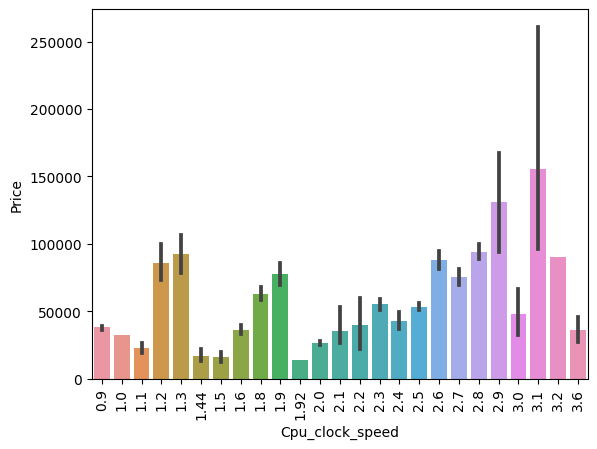

In [63]:
# you can see that the higher clock speeds generallly have higher price
sns.barplot(x=df['Cpu_clock_speed'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

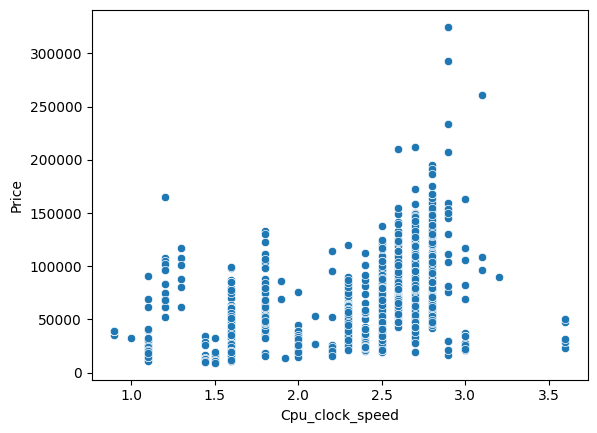

In [64]:
sns.scatterplot(x= df['Cpu_clock_speed'], y= df['Price'])
plt.show()

In [65]:
# now the whole cpu column is processed so drop the column
df.drop(columns=['Cpu'], inplace=True)
df.sample(5)

,Company,TypeName,Inches,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_name,Cpu_clock_speed
898,Dell,Notebook,15.6,4,1TB HDD,AMD Radeon R5 M420X,Windows 10,2.18,32713.920,0,0,1366,768,100,0,Intel Core i3,2.0
45,Apple,Ultrabook,13.3,8,256GB SSD,Intel Iris Graphics 540,macOS,1.37,75604.320,0,1,2560,1600,227,1,Intel Core i5,2.0
1049,Asus,Netbook,11.6,4,16GB Flash Storage,Intel HD Graphics 400,Chrome OS,1.20,15339.312,0,0,1366,768,135,0,other Intel processors,1.6
23,Dell,2 in 1 Convertible,13.3,8,256GB SSD,Intel UHD Graphics 620,Windows 10,1.62,43636.320,1,0,1920,1080,166,0,Intel Core i5,1.6
1064,MSI,Gaming,15.6,16,256GB SSD + 1TB HDD,Nvidia GeForce GTX 1060,Windows 10,1.80,102777.120,0,0,1920,1080,141,0,Intel Core i7,2.6


In [66]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1302 entries, 0 to 1302
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Company          1302 non-null   object 
 1   TypeName         1302 non-null   object 
 2   Inches           1302 non-null   float64
 3   Ram              1302 non-null   int32  
 4   Memory           1302 non-null   object 
 5   Gpu              1302 non-null   object 
 6   OpSys            1302 non-null   object 
 7   Weight           1302 non-null   float32
 8   Price            1302 non-null   float64
 9   Touchscreen      1302 non-null   int64  
 10  IPS              1302 non-null   int64  
 11  Res_width        1302 non-null   int32  
 12  Res_height       1302 non-null   int32  
 13  PPI              1302 non-null   int64  
 14  Retina           1302 non-null   int64  
 15  Cpu_name         1302 non-null   object 
 16  Cpu_clock_speed  1302 non-null   float32
dtypes: float32(2),

8     619
4     374
16    200
6      41
12     25
2      22
32     17
24      3
64      1
Name: Ram, dtype: int64


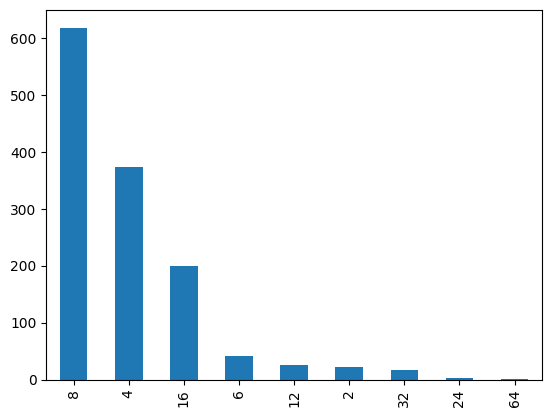

In [67]:
# now lets work on the ram and observe the correlation betweeen ram and price
print(df['Ram'].value_counts())
df['Ram'].value_counts().plot(kind="bar")
plt.show()

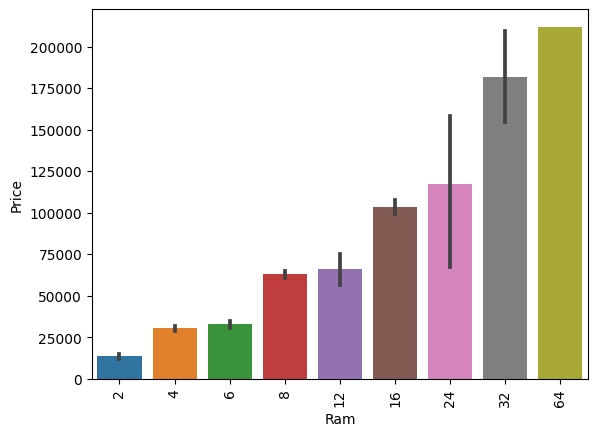

In [68]:
sns.barplot(x=df['Ram'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

In [69]:
# lets now process the memory column
df['Memory'].value_counts()

256GB SSD                        412
1TB HDD                          223
500GB HDD                        132
512GB SSD                        118
128GB SSD +  1TB HDD              94
128GB SSD                         76
256GB SSD +  1TB HDD              73
32GB Flash Storage                37
2TB HDD                           16
64GB Flash Storage                15
512GB SSD +  1TB HDD              14
1TB SSD                           14
256GB SSD +  2TB HDD              10
1.0TB Hybrid                       9
256GB Flash Storage                8
16GB Flash Storage                 7
32GB SSD                           6
180GB SSD                          5
128GB Flash Storage                4
512GB SSD +  2TB HDD               3
16GB SSD                           3
512GB Flash Storage                2
1TB SSD +  1TB HDD                 2
256GB SSD +  500GB HDD             2
128GB SSD +  2TB HDD               2
256GB SSD +  256GB SSD             2
512GB SSD +  256GB SSD             1
5

In [70]:
# this is a very diffciult column to handle due to variable properties so lets make 4 columns
# HDD, SSD, Flash_storage and Hybrid
# each of them contains the memory value in the text above

# there is another problem with the TB and GB we should convert everything to GB for better results

In [71]:
def extract_hdd_info(text):
    text_list= text.split(" ")
    if "HDD" in text_list:
        idx = text_list.index("HDD")
        mem= int(float(text_list[idx-1][:-2]))
        if mem < 5:
            mem= mem*1024
        return mem
    else:
        return 0
        
def extract_ssd_info(text):
    text_list= text.split(" ")
    if "SSD" in text_list:
        idx = text_list.index("SSD")
        mem= int(float(text_list[idx-1][:-2]))
        if mem < 5:
            mem= mem*1024
        return mem
    else:
        return 0
        
def extract_hybrid_info(text):
    text_list= text.split(" ")
    if "Hybrid" in text_list:
        idx = text_list.index("Hybrid")
        mem= int(float(text_list[idx-1][:-2]))
        if mem < 5:
            mem= mem*1024
        return mem
    else:
        return 0
        
def extract_flash_info(text):
    text_list= text.split(" ")
    if "Flash" in text_list:
        idx = text_list.index("Flash")
        mem= int(float(text_list[idx-1][:-2]))
        if mem < 5:
            mem= mem*1024
        return mem
    else:
        return 0

In [72]:
df['HDD']= df['Memory'].apply(extract_hdd_info)
df['SSD']= df['Memory'].apply(extract_ssd_info)
df['Hybrid']= df['Memory'].apply(extract_hybrid_info)
df['Flash_storage']= df['Memory'].apply(extract_flash_info)
df.sample(5)

,Company,TypeName,Inches,Ram,Memory,Gpu,OpSys,Weight,Price,Touchscreen,...,Res_width,Res_height,PPI,Retina,Cpu_name,Cpu_clock_speed,HDD,SSD,Hybrid,Flash_storage
319,Acer,Notebook,11.6,4,128GB Flash Storage,Intel HD Graphics 405,Windows 10,1.400,25840.80,0,...,1366,768,135,0,other Intel processors,1.6,0,0,0,128
357,Dell,Gaming,15.6,8,1TB HDD,Nvidia GeForce GTX 1050,Windows 10,2.650,53226.72,0,...,1920,1080,141,0,Intel Core i5,2.5,1024,0,0,0
895,Toshiba,Notebook,13.3,8,256GB SSD,Intel HD Graphics 620,Windows 10,1.050,78588.00,0,...,1920,1080,166,0,Intel Core i5,2.5,0,256,0,0
1250,Dell,Notebook,15.6,4,500GB HDD,Intel HD Graphics,Linux,2.200,17262.72,0,...,1366,768,100,0,other Intel processors,1.6,500,0,0,0
457,Microsoft,Ultrabook,13.5,4,128GB SSD,Intel HD Graphics 615,Windows 10 S,1.252,52693.92,1,...,2256,1504,201,0,Intel Core M,2.2,0,128,0,0


In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1302 entries, 0 to 1302
Data columns (total 21 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Company          1302 non-null   object 
 1   TypeName         1302 non-null   object 
 2   Inches           1302 non-null   float64
 3   Ram              1302 non-null   int32  
 4   Memory           1302 non-null   object 
 5   Gpu              1302 non-null   object 
 6   OpSys            1302 non-null   object 
 7   Weight           1302 non-null   float32
 8   Price            1302 non-null   float64
 9   Touchscreen      1302 non-null   int64  
 10  IPS              1302 non-null   int64  
 11  Res_width        1302 non-null   int32  
 12  Res_height       1302 non-null   int32  
 13  PPI              1302 non-null   int64  
 14  Retina           1302 non-null   int64  
 15  Cpu_name         1302 non-null   object 
 16  Cpu_clock_speed  1302 non-null   float32
 17  HDD           

In [74]:
# now lets drop the meory columns as it is being processed
df.drop(columns=["Memory"], inplace=True)
df.head()

,Company,TypeName,Inches,Ram,Gpu,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_name,Cpu_clock_speed,HDD,SSD,Hybrid,Flash_storage
0,Apple,Ultrabook,13.3,8,Intel Iris Plus Graphics 640,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel Core i5,2.3,0,128,0,0
1,Apple,Ultrabook,13.3,8,Intel HD Graphics 6000,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel Core i5,1.8,0,0,0,128
2,HP,Notebook,15.6,8,Intel HD Graphics 620,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel Core i5,2.5,0,256,0,0
3,Apple,Ultrabook,15.4,16,AMD Radeon Pro 455,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel Core i7,2.7,0,512,0,0
4,Apple,Ultrabook,13.3,8,Intel Iris Plus Graphics 650,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel Core i5,3.1,0,256,0,0


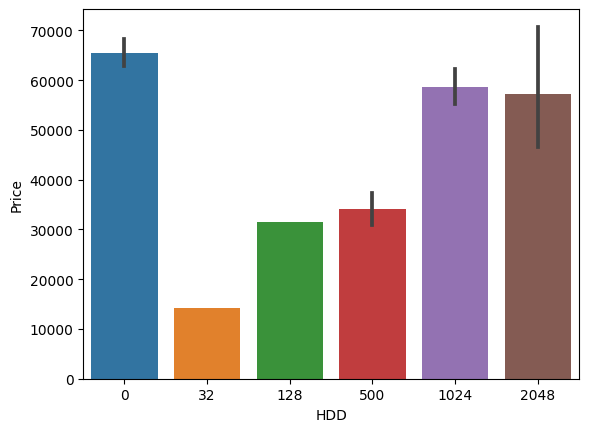

In [75]:
sns.barplot(x=df['HDD'], y=df['Price'])
plt.show()

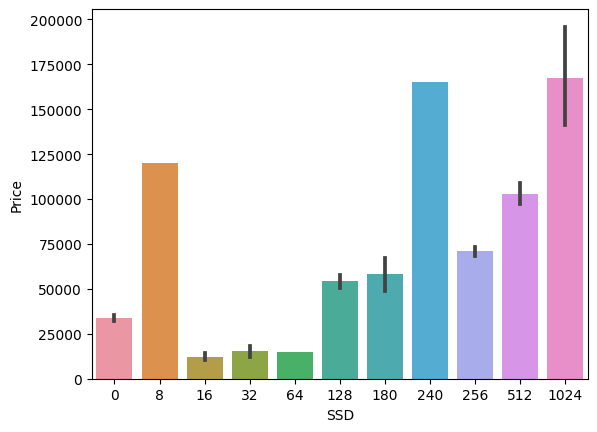

In [76]:
sns.barplot(x=df['SSD'], y=df['Price'])

plt.show()

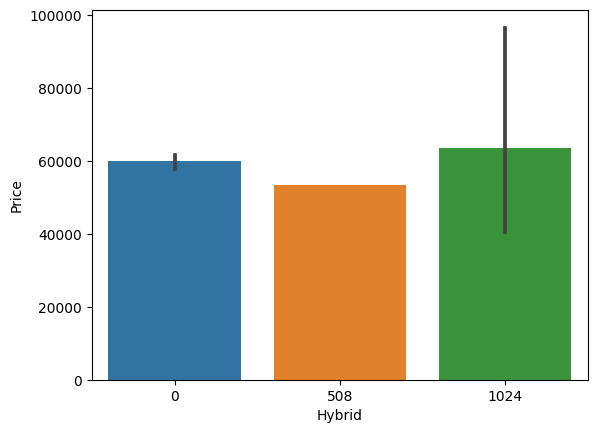

In [77]:
sns.barplot(x=df['Hybrid'], y=df['Price'])
plt.show()

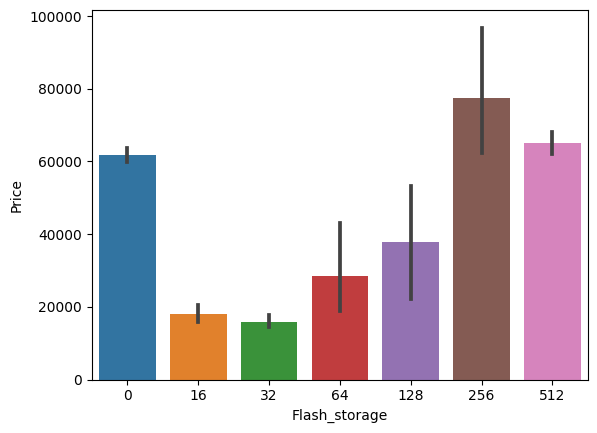

In [78]:
sns.barplot(x=df['Flash_storage'], y=df['Price'])

plt.show()

In [79]:
df['Gpu'].value_counts()

Intel HD Graphics 620      281
Intel HD Graphics 520      185
Intel UHD Graphics 620      68
Nvidia GeForce GTX 1050     66
Nvidia GeForce GTX 1060     48
                          ... 
Intel Graphics 620           1
AMD Radeon R5 520            1
AMD Radeon R7                1
Intel HD Graphics 540        1
Nvidia GeForce 960M          1
Name: Gpu, Length: 109, dtype: int64

Intel     722
Nvidia    400
AMD       180
Name: Gpu_brand, dtype: int64


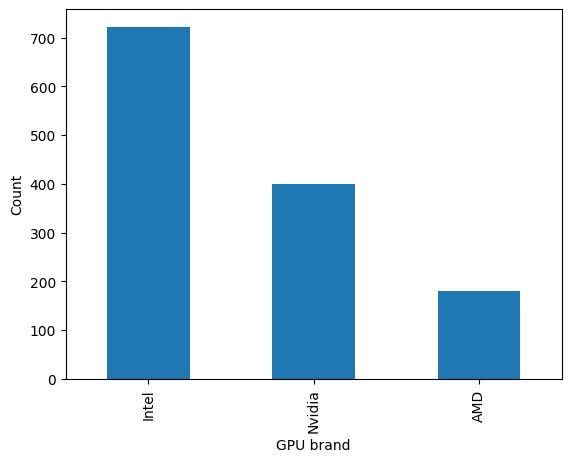

In [80]:
# from above clearly it has lot of categories no beenefit in extracting all model of gpu 
# just extact the brand of gpu because theres no memory info 
# now lets process the Gpu column
df['Gpu_brand']= df['Gpu'].apply(lambda x:x.split(" ")[0])
print(df['Gpu_brand'].value_counts())
df['Gpu_brand'].value_counts().plot(kind="bar")
plt.xlabel('GPU brand')
plt.ylabel('Count')
plt.show()

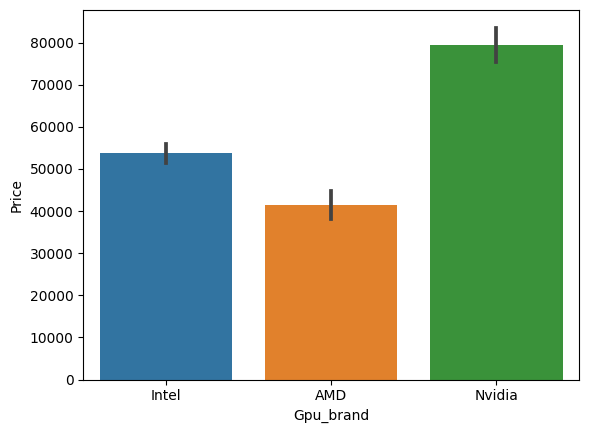

In [81]:
sns.barplot(x=df['Gpu_brand'], y=df['Price'])

plt.show()

In [82]:
# now gpu is processed so lets drop the gpu column
df.drop(columns= ["Gpu"], inplace=True)
df.head()

,Company,TypeName,Inches,Ram,OpSys,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_name,Cpu_clock_speed,HDD,SSD,Hybrid,Flash_storage,Gpu_brand
0,Apple,Ultrabook,13.3,8,macOS,1.37,71378.6832,0,1,2560,1600,227,1,Intel Core i5,2.3,0,128,0,0,Intel
1,Apple,Ultrabook,13.3,8,macOS,1.34,47895.5232,0,0,1440,900,128,0,Intel Core i5,1.8,0,0,0,128,Intel
2,HP,Notebook,15.6,8,No OS,1.86,30636.0000,0,0,1920,1080,141,0,Intel Core i5,2.5,0,256,0,0,Intel
3,Apple,Ultrabook,15.4,16,macOS,1.83,135195.3360,0,1,2880,1800,221,1,Intel Core i7,2.7,0,512,0,0,AMD
4,Apple,Ultrabook,13.3,8,macOS,1.37,96095.8080,0,1,2560,1600,227,1,Intel Core i5,3.1,0,256,0,0,Intel


In [83]:
# now lets process the OpSys column
df['OpSys'].value_counts()

Windows 10      1072
No OS             66
Linux             62
Windows 7         45
Chrome OS         26
macOS             13
Mac OS X           8
Windows 10 S       8
Android            2
Name: OpSys, dtype: int64

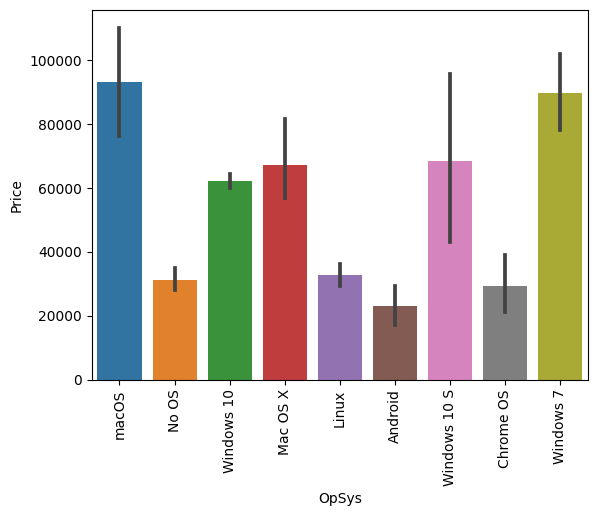

In [84]:
sns.barplot(x=df['OpSys'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

In [85]:
# From the above diagram it is clear that we can group categoris
# lets make the categories mac os, windows and linux/android/chrome os/no os

In [86]:
def cat_os(text):
    if text=="Windows 10" or text=="Windows 10 S" or text=="Windows 7":
        return "Windows"
    elif text=="macOS" or text=="Mac OS X":
        return "Mac"
    else:
        return "Linux/Android/Chrome OS/No OS"

Windows                          1125
Linux/Android/Chrome OS/No OS     156
Mac                                21
Name: OS, dtype: int64


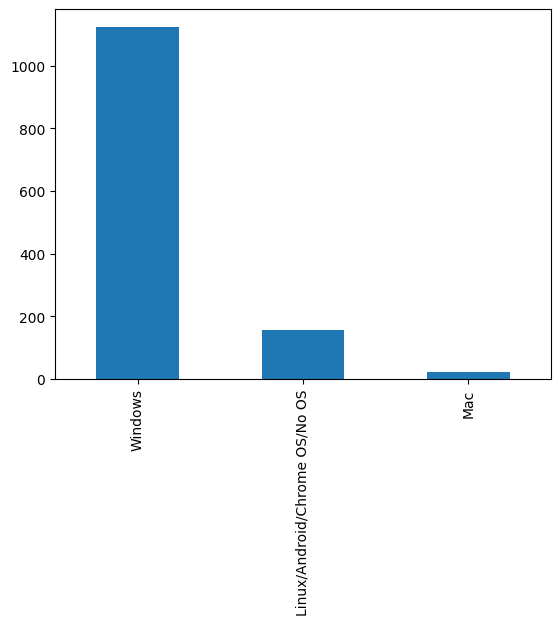

In [87]:
df['OS']= df['OpSys'].apply(cat_os)
print(df['OS'].value_counts())
df['OS'].value_counts().plot(kind="bar")
plt.show()

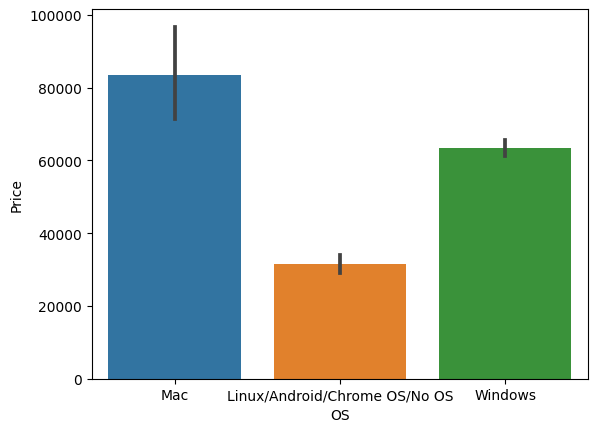

In [88]:
sns.barplot(x=df['OS'], y=df['Price'])
plt.show()

In [89]:
# now drop the opsys column
df.drop(columns=['OpSys'], inplace=True)
print(df.shape)
df

(1302, 20)


,Company,TypeName,Inches,Ram,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_name,Cpu_clock_speed,HDD,SSD,Hybrid,Flash_storage,Gpu_brand,OS
0,Apple,Ultrabook,13.3,8,1.37,71378.6832,0,1,2560,1600,227,1,Intel Core i5,2.3,0,128,0,0,Intel,Mac
1,Apple,Ultrabook,13.3,8,1.34,47895.5232,0,0,1440,900,128,0,Intel Core i5,1.8,0,0,0,128,Intel,Mac
2,HP,Notebook,15.6,8,1.86,30636.0000,0,0,1920,1080,141,0,Intel Core i5,2.5,0,256,0,0,Intel,Linux/Android/Chrome OS/No OS
3,Apple,Ultrabook,15.4,16,1.83,135195.3360,0,1,2880,1800,221,1,Intel Core i7,2.7,0,512,0,0,AMD,Mac
4,Apple,Ultrabook,13.3,8,1.37,96095.8080,0,1,2560,1600,227,1,Intel Core i5,3.1,0,256,0,0,Intel,Mac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1298,Lenovo,2 in 1 Convertible,14.0,4,1.80,33992.6400,1,1,1920,1080,157,0,Intel Core i7,2.5,0,128,0,0,Intel,Windows
1299,Lenovo,2 in 1 Convertible,13.3,16,1.30,79866.7200,1,1,3200,1800,276,0,Intel Core i7,2.5,0,512,0,0,Intel,Windows
1300,Lenovo,Notebook,14.0,2,1.50,12201.1200,0,0,1366,768,112,0,other Intel processors,1.6,0,0,0,64,Intel,Windows
1301,HP,Notebook,15.6,6,2.19,40705.9200,0,0,1366,768,100,0,Intel Core i7,2.5,1024,0,0,0,AMD,Windows


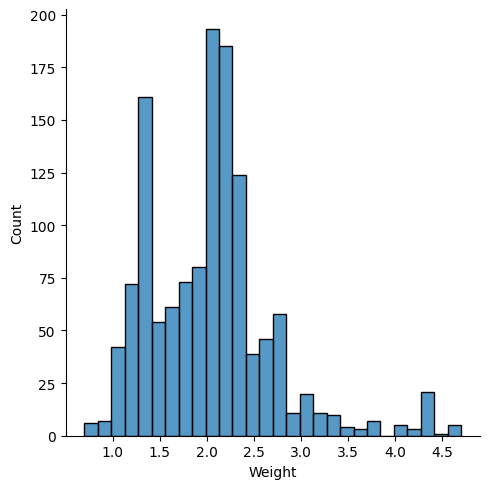

In [90]:
# weight distribution
df['Weight'] = np.round(df['Weight'], decimals=1)
sns.displot(df['Weight'])
plt.show()

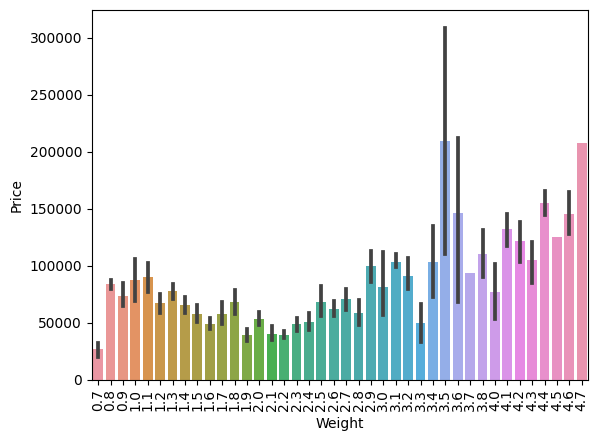

In [91]:
sns.barplot(x=df['Weight'], y=df['Price'])
plt.xticks(rotation=90)
plt.show()

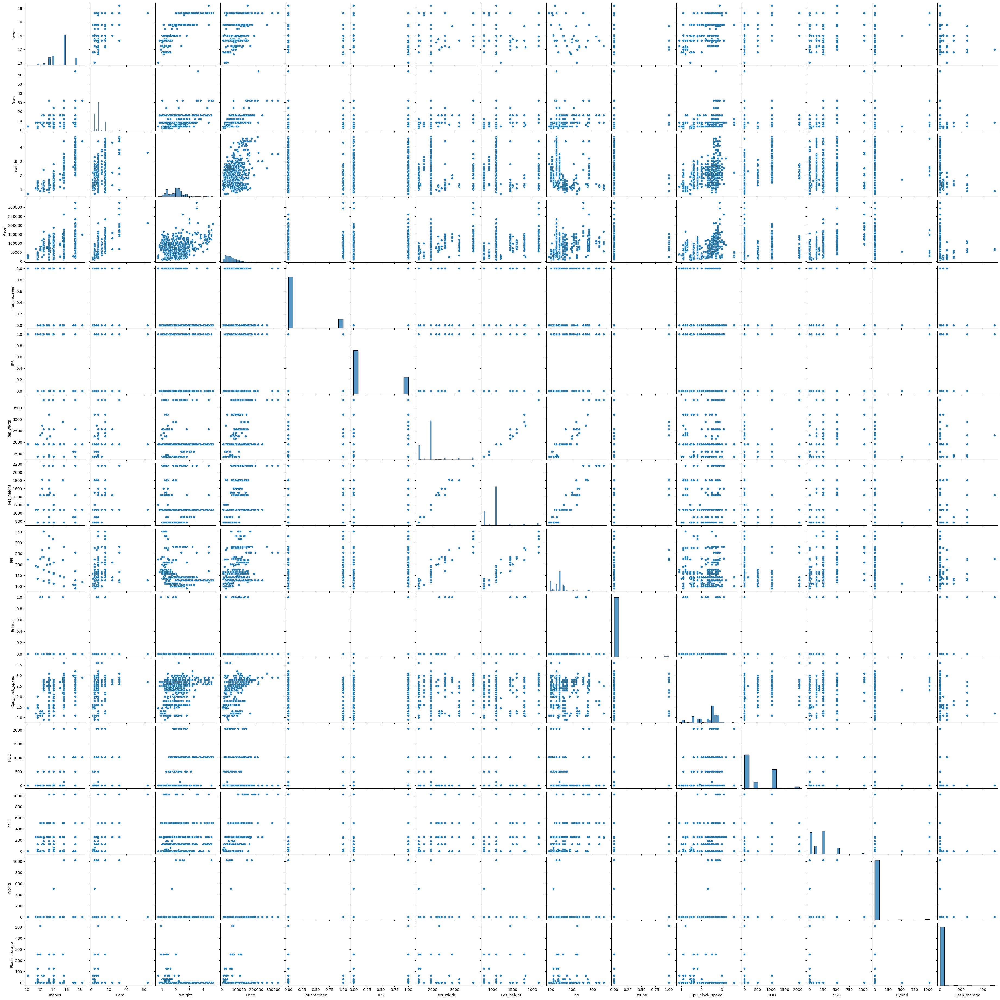

In [92]:
# lets do a pairplot of all the numerical columns in the dataset
sns.pairplot(df)
plt.show()

# CORRELATION ANALYSIS

In [93]:
# now lets do the correlation analysis 
df.corr()

,Inches,Ram,Weight,Price,Touchscreen,IPS,Res_width,Res_height,PPI,Retina,Cpu_clock_speed,HDD,SSD,Hybrid,Flash_storage
Inches,1.000000,0.237129,0.826108,0.067329,-0.359514,-0.112726,-0.069875,-0.092934,-0.414771,-0.140740,0.307476,0.531223,-0.109818,0.054102,-0.228868
Ram,0.237129,1.000000,0.382876,0.742905,0.118875,0.207949,0.434095,0.426357,0.305546,0.031206,0.367764,0.099302,0.604520,0.038515,-0.059612
Weight,0.826108,0.382876,1.000000,0.210509,-0.290313,0.020365,-0.031764,-0.051958,-0.322778,-0.122736,0.320305,0.513734,-0.060239,0.092497,-0.181234
Price,0.067329,0.742905,0.210509,1.000000,0.192917,0.253320,0.557369,0.554591,0.475475,0.087852,0.430122,-0.094530,0.675849,0.007963,-0.040067
Touchscreen,-0.359514,0.118875,-0.290313,0.192917,1.000000,0.148026,0.350097,0.355756,0.459330,-0.047691,-0.081681,-0.208055,0.256521,-0.039571,-0.020809
IPS,-0.112726,0.207949,0.020365,0.253320,0.148026,1.000000,0.280588,0.287404,0.299469,0.184639,0.063833,-0.091797,0.228027,-0.022456,0.068616
Res_width,-0.069875,0.434095,-0.031764,0.557369,0.350097,0.280588,1.000000,0.994480,0.930895,0.153742,0.184110,-0.123565,0.534657,0.000328,-0.017177
Res_height,-0.092934,0.426357,-0.051958,0.554591,0.355756,0.287404,0.994480,1.000000,0.938701,0.215896,0.170761,-0.134844,0.526971,-0.001306,0.014996
PPI,-0.414771,0.305546,-0.322778,0.475475,0.459330,0.299469,0.930895,0.938701,1.000000,0.216593,0.044035,-0.294819,0.515229,-0.020051,0.076627
Retina,-0.140740,0.031206,-0.122736,0.087852,-0.047691,0.184639,0.153742,0.215896,0.216593,1.000000,-0.061248,-0.092244,0.031047,-0.010977,0.397690


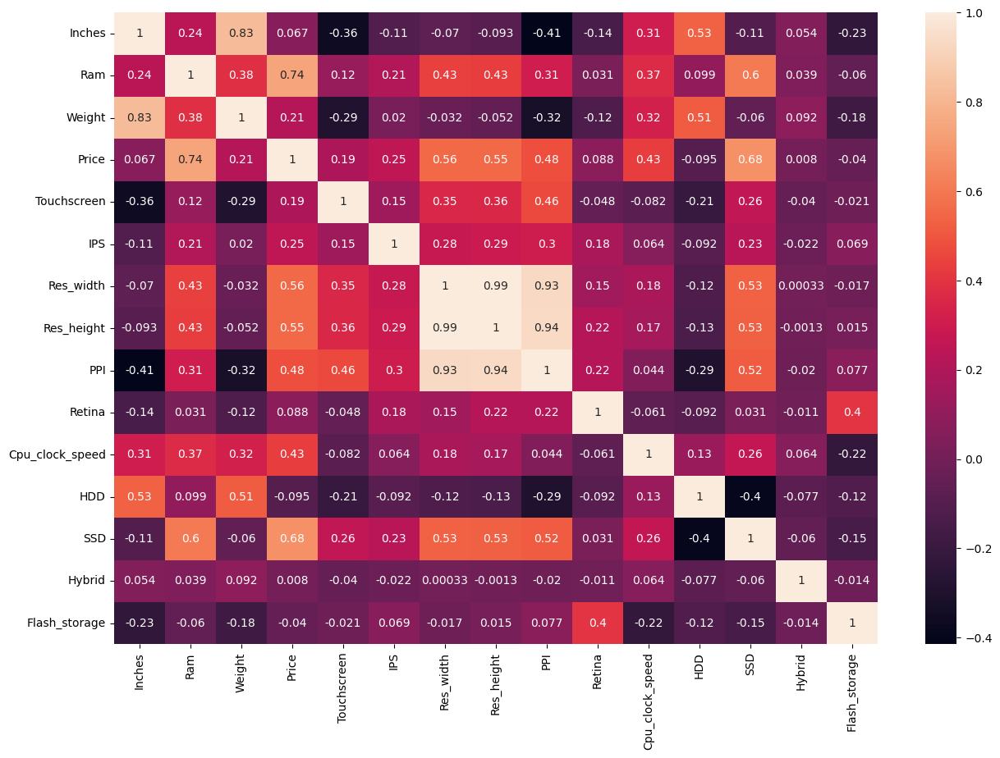

In [94]:
plt.subplots(figsize=(15,10))
sns.heatmap(df.corr(), annot=True)
plt.show()

In [95]:
# from the plot above it is clear that res_height and res_width are very correlated and we already formed ppi from it so drop these columns
df.drop(columns=['Res_height', 'Res_width'], inplace=True)
print(df.shape)
df

(1302, 18)


,Company,TypeName,Inches,Ram,Weight,Price,Touchscreen,IPS,PPI,Retina,Cpu_name,Cpu_clock_speed,HDD,SSD,Hybrid,Flash_storage,Gpu_brand,OS
0,Apple,Ultrabook,13.3,8,1.4,71378.6832,0,1,227,1,Intel Core i5,2.3,0,128,0,0,Intel,Mac
1,Apple,Ultrabook,13.3,8,1.3,47895.5232,0,0,128,0,Intel Core i5,1.8,0,0,0,128,Intel,Mac
2,HP,Notebook,15.6,8,1.9,30636.0000,0,0,141,0,Intel Core i5,2.5,0,256,0,0,Intel,Linux/Android/Chrome OS/No OS
3,Apple,Ultrabook,15.4,16,1.8,135195.3360,0,1,221,1,Intel Core i7,2.7,0,512,0,0,AMD,Mac
4,Apple,Ultrabook,13.3,8,1.4,96095.8080,0,1,227,1,Intel Core i5,3.1,0,256,0,0,Intel,Mac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1298,Lenovo,2 in 1 Convertible,14.0,4,1.8,33992.6400,1,1,157,0,Intel Core i7,2.5,0,128,0,0,Intel,Windows
1299,Lenovo,2 in 1 Convertible,13.3,16,1.3,79866.7200,1,1,276,0,Intel Core i7,2.5,0,512,0,0,Intel,Windows
1300,Lenovo,Notebook,14.0,2,1.5,12201.1200,0,0,112,0,other Intel processors,1.6,0,0,0,64,Intel,Windows
1301,HP,Notebook,15.6,6,2.2,40705.9200,0,0,100,0,Intel Core i7,2.5,1024,0,0,0,AMD,Windows


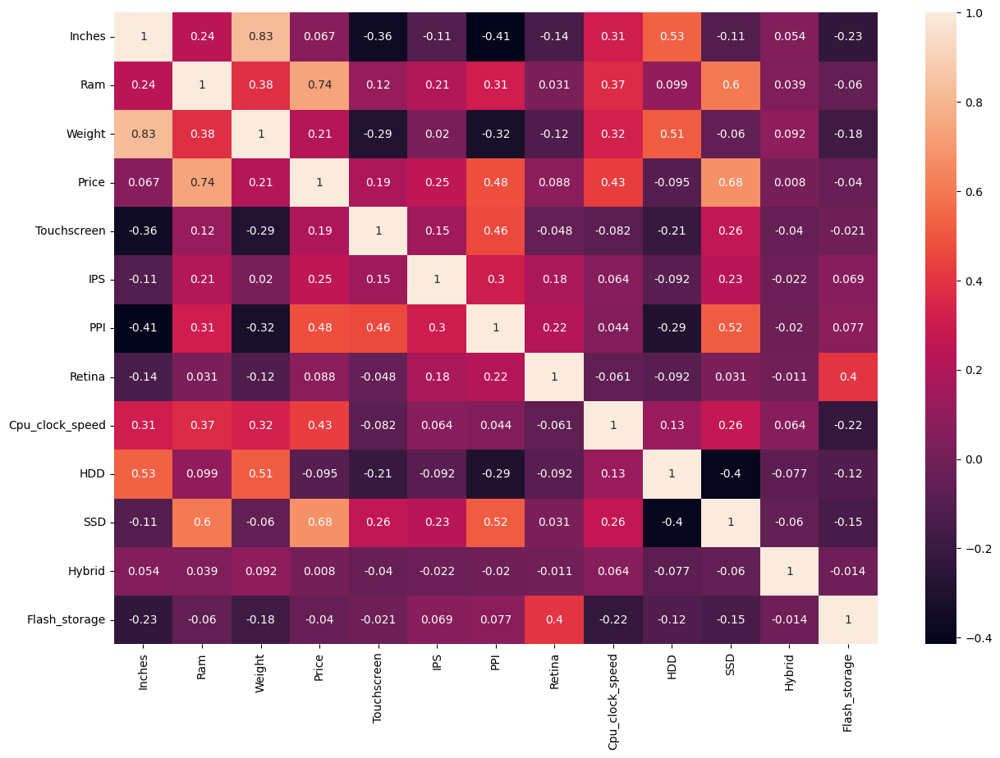

In [96]:
plt.subplots(figsize=(15,10))
sns.heatmap(df.corr(), annot=True)
plt.show()

In [97]:
# some of the columns have very less correlation so lets remove those columns
df_filtered= df.drop(columns=['Hybrid', 'Flash_storage', 'HDD'], inplace=False)
df_filtered

,Company,TypeName,Inches,Ram,Weight,Price,Touchscreen,IPS,PPI,Retina,Cpu_name,Cpu_clock_speed,SSD,Gpu_brand,OS
0,Apple,Ultrabook,13.3,8,1.4,71378.6832,0,1,227,1,Intel Core i5,2.3,128,Intel,Mac
1,Apple,Ultrabook,13.3,8,1.3,47895.5232,0,0,128,0,Intel Core i5,1.8,0,Intel,Mac
2,HP,Notebook,15.6,8,1.9,30636.0000,0,0,141,0,Intel Core i5,2.5,256,Intel,Linux/Android/Chrome OS/No OS
3,Apple,Ultrabook,15.4,16,1.8,135195.3360,0,1,221,1,Intel Core i7,2.7,512,AMD,Mac
4,Apple,Ultrabook,13.3,8,1.4,96095.8080,0,1,227,1,Intel Core i5,3.1,256,Intel,Mac
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1298,Lenovo,2 in 1 Convertible,14.0,4,1.8,33992.6400,1,1,157,0,Intel Core i7,2.5,128,Intel,Windows
1299,Lenovo,2 in 1 Convertible,13.3,16,1.3,79866.7200,1,1,276,0,Intel Core i7,2.5,512,Intel,Windows
1300,Lenovo,Notebook,14.0,2,1.5,12201.1200,0,0,112,0,other Intel processors,1.6,0,Intel,Windows
1301,HP,Notebook,15.6,6,2.2,40705.9200,0,0,100,0,Intel Core i7,2.5,0,AMD,Windows


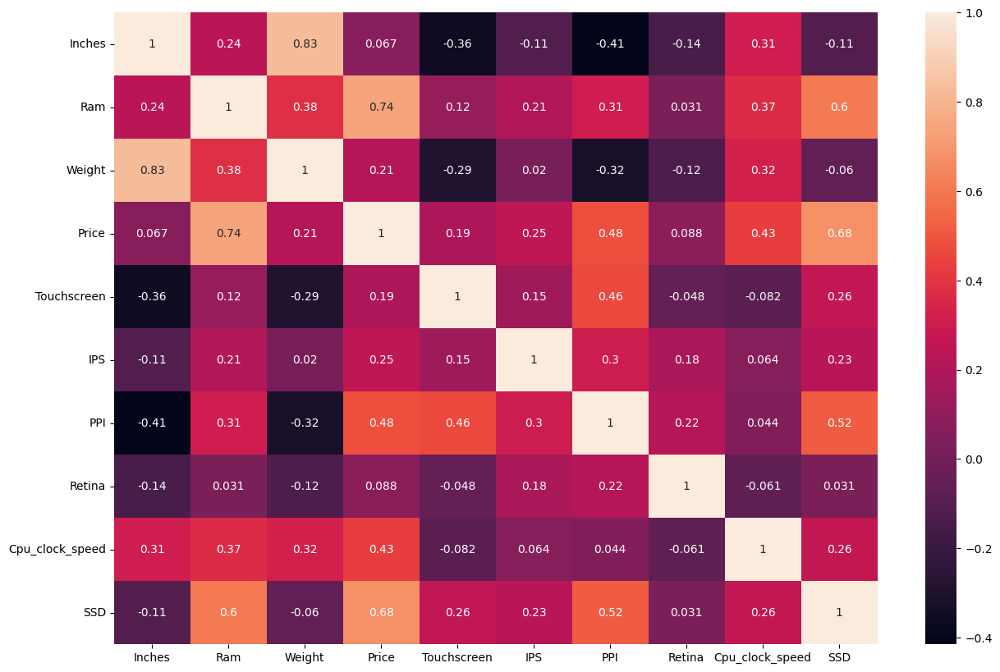

In [98]:
plt.subplots(figsize=(15,10))
sns.heatmap(df_filtered.corr(), annot=True)
plt.show()

In [99]:
# now lets start building the pipeline for regression

# REGRESSION PIPELINE

In [100]:
# preprocessing 
from sklearn.model_selection import train_test_split

# pipelining
from sklearn.pipeline import Pipeline

# models
from sklearn.svm import SVR 
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import SGDRegressor
from sklearn.neighbors import KNeighborsRegressor 
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.isotonic import IsotonicRegression
from xgboost import XGBRegressor

# hyperparameter tuning
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

# metrics
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error

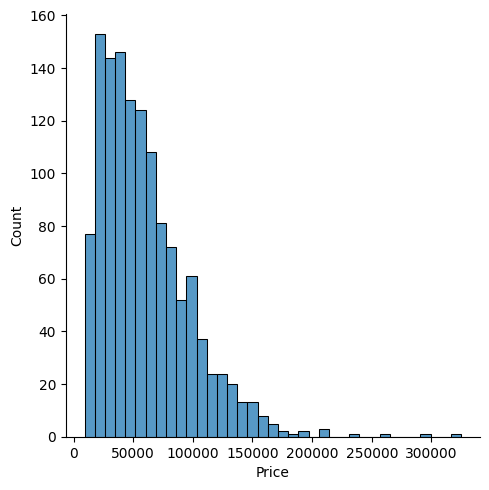

In [101]:
# target column
sns.displot(df['Price'])
plt.show()

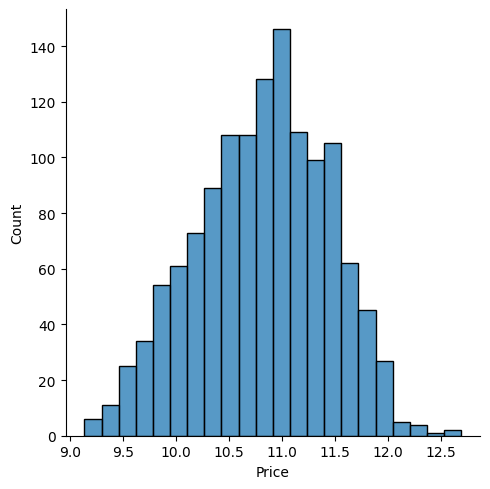

In [102]:
# so lets apply log to the price so that it is not skewed ande easy to predict
sns.displot(np.log(df['Price']))
plt.show()

In [103]:
df_encoded= pd.get_dummies(df, columns=['Company', 'TypeName', 'Ram', 'Cpu_name', 'HDD', 'SSD', 'Hybrid','Flash_storage', 'Gpu_brand', 'OS'])
X= df_encoded.drop(columns=["Price"])
print(X.shape)
y= np.log(df_encoded['Price'])
# y= df_encoded['Price']
print(y.shape)

(1302, 82)
(1302,)


In [104]:
X.head()

,Inches,Weight,Touchscreen,IPS,PPI,Retina,Cpu_clock_speed,Company_Acer,Company_Apple,Company_Asus,...,Flash_storage_64,Flash_storage_128,Flash_storage_256,Flash_storage_512,Gpu_brand_AMD,Gpu_brand_Intel,Gpu_brand_Nvidia,OS_Linux/Android/Chrome OS/No OS,OS_Mac,OS_Windows
0,13.3,1.4,0,1,227,1,2.3,0,1,0,...,0,0,0,0,0,1,0,0,1,0
1,13.3,1.3,0,0,128,0,1.8,0,1,0,...,0,1,0,0,0,1,0,0,1,0
2,15.6,1.9,0,0,141,0,2.5,0,0,0,...,0,0,0,0,0,1,0,1,0,0
3,15.4,1.8,0,1,221,1,2.7,0,1,0,...,0,0,0,0,1,0,0,0,1,0
4,13.3,1.4,0,1,227,1,3.1,0,1,0,...,0,0,0,0,0,1,0,0,1,0


In [105]:
y.head()

0    11.175755
1    10.776777
2    10.329931
3    11.814476
4    11.473101
Name: Price, dtype: float64

In [106]:
X_train, X_test, y_train, y_test= train_test_split(X, y, test_size=0.2, random_state= 42)
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(1041, 82)
(261, 82)
(1041,)
(261,)


In [107]:
X.head(1)

,Inches,Weight,Touchscreen,IPS,PPI,Retina,Cpu_clock_speed,Company_Acer,Company_Apple,Company_Asus,...,Flash_storage_64,Flash_storage_128,Flash_storage_256,Flash_storage_512,Gpu_brand_AMD,Gpu_brand_Intel,Gpu_brand_Nvidia,OS_Linux/Android/Chrome OS/No OS,OS_Mac,OS_Windows
0,13.3,1.4,0,1,227,1,2.3,0,1,0,...,0,0,0,0,0,1,0,0,1,0


In [108]:
# initializing all the models
svr = SVR()
lr = LinearRegression()
rlr = Ridge()
llr = Lasso()
elr = ElasticNet()
sgdr = SGDRegressor()
knr = KNeighborsRegressor()
gpr = GaussianProcessRegressor()
dtr = DecisionTreeRegressor()
gbr = GradientBoostingRegressor()
rfr = RandomForestRegressor()
xgbr = XGBRegressor()
mlpr = MLPRegressor() 
ir = IsotonicRegression()

In [109]:
def regression_pipeline(model, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False):
    results= dict()

    # transform= ColumnTransformer(transformers=[
    #     ('col_trf', OneHotEncoder(sparse= False, drop= 'first'), [0,1,3,9,11,12,13,14,15,16])
    # ], remainder='passthrough')
    
    if(model==svr):
        grid_params={'kernel':['linear', 'poly', 'rbf', 'sigmoid'], 
                     'C':[0.0001,0.001,0.01,0.1,1,10]}
    # elif(model==lr):
    #     grid_params={}
    elif(model==rlr):
        grid_params={'alpha':[0.0001,0.001,0.01,0.1,1,10]}
    elif(model==llr):
        grid_params={'alpha':[0.0001,0.001,0.01,0.1,1,10]}
    elif(model==elr):
        grid_params={'alpha':[0.0001,0.001,0.01,0.1,1,10], 
                     'l1_ratio':[0.25,0.50,0.75]}    
    elif(model==sgdr):
        grid_params={'penalty': ['l2', 'l1', 'elasticnet'], 
                     'alpha':[0.0001,0.001,0.01,0.1,1,10]}
    elif(model==knr):
        grid_params={'n_neighbors':np.arange(1,100,2), 
                     'leaf_size':np.arange(2,501)}
    elif(model==gpr):
        grid_params={'alpha':[0.0001,0.001,0.01,0.1,1,10], 
                     'normalize_y':[True, False]}
    elif(model==dtr):
        # grid_params={'criterion': ['squared_error','friedman_mse','absolute_error','poisson'], 'max_depth':np.arange(2,501), 'max_leaf_nodes':np.arange(2,501)}
        grid_params={
                    #  'criterion': ['squared_error','friedman_mse','absolute_error','poisson'],
                    #  'splitter': ['best', 'random'],
                     'max_depth': np.arange(1, 11),
                     'min_samples_split': np.arange(2, 11),
                     'min_samples_leaf': np.arange(1, 11),
                    #  'max_features': ['sqrt', 'log2', None],
                     'max_leaf_nodes': np.arange(2, 11),
                     'min_impurity_decrease': [0.0, 0.1, 0.2]}
    elif(model==gbr):
        # grid_params={'criterion': ['squared_error','friedman_mse'], 'learning_rate':[0.0001,0.001,0.01,0.1], 'n_estimators':np.arange(2,501), 'max_depth':np.arange(2,501), 'alpha':[0.0001,0.001,0.01,0.1,0.2,0.5,0.9]}
        if not exhaustive:
            grid_params={
                      # 'loss': ['squared_error', 'absolute_error', 'huber', 'quantile'],
                      'learning_rate':[0.0001,0.001,0.01],
                      'n_estimators':np.arange(50,501,50),
                      'max_depth':np.arange(3, 11, 1),
                      'min_samples_split': np.arange(2, 10),
                      'min_samples_leaf':np.arange(1,11),
                      'subsample':np.arange(0.1,1,0.2),
                      'max_features':np.arange(0.1,1,0.2),
                      'alpha':[0.0001,0.001,0.01,0.1]}
        else:
            grid_params={
                      # 'loss': ['squared_error', 'absolute_error', 'huber', 'quantile'],
                      'learning_rate':[0.001,0.01, 0.1],
                      'n_estimators':np.arange(50,201,50),
                      'max_depth':np.arange(3, 11, 1),
                      'min_samples_split': np.arange(2, 10, 2),
                      'min_samples_leaf':np.arange(1,11, 2),
                      'alpha':[0.001,0.01,0.1]}
    elif(model==rfr):
        grid_params ={'n_estimators':np.arange(50,501,50),
                    'max_depth':np.arange(3,11,1),
                    'min_samples_split': np.arange(2,20),  
                    'min_samples_leaf':np.arange(1,11),  
                    'max_features': ['log2', 'sqrt', None],
                    'min_impurity_decrease': [0.0, 0.1, 0.2, 0.3, 0.4, 0.5],
                    'bootstrap':[True, False]}
    elif(model==xgbr):
        if not exhaustive:
            grid_params ={'n_estimators': [100, 200, 300, 500],  
                        'learning_rate': [0.001, 0.01, 0.05, 0.1],  
                        'max_depth': [3, 5, 7, 9, 11, 15, 19],  
                        'min_child_weight': [1, 5, 10],  
                        'subsample': [0.5, 0.7, 0.9],  
                        'colsample_bytree': [0.5, 0.7, 0.9],  
                        'gamma': [0, 0.1, 0.2],  
                        'reg_alpha': [0, 0.1, 0.5, 1],  
                        'reg_lambda': [0, 0.1, 0.5, 1],  
                        'objective': ['reg:squarederror', 'reg:squaredlogerror']}
        else:
            grid_params ={'n_estimators': [100, 200, 300, 500],  
                        'learning_rate': [0.01, 0.05, 0.1],  
                        'max_depth': [3, 5, 7, 9], 
                        'subsample': [0.5, 0.7, 0.9],  
                        'reg_alpha': [0.1, 0.5, 1],  
                        'reg_lambda': [0.1, 0.5, 1],  
                        'objective': ['reg:squarederror', 'reg:squaredlogerror']}
        
    elif(model==mlpr):
        grid_params ={'hidden_layer_sizes': [(50,), (100,), (50, 50), (100, 50)],  
                    'activation': ['relu', 'tanh', 'logistic'],  
                    'solver': ['adam', 'lbfgs', 'sgd'],  
                    'alpha': [0.001, 0.01, 0.1],  
                    'learning_rate': ['constant', 'invscaling', 'adaptive'],  
                    'learning_rate_init': [0.001, 0.01, 0.1],  
                    'batch_size': [32, 64, 128],  
                    'max_iter': [100, 200, 300],  
                    'early_stopping': [True, False]}
    else:
        grid_params={}
        
    if tuning==True and exhaustive==True:
        model= GridSearchCV(model, grid_params, scoring='r2', verbose=10, cv=5, n_jobs=-1)
    elif tuning==True and exhaustive==False:
        model= RandomizedSearchCV(model, grid_params, scoring='r2', verbose=10, cv=5, n_jobs=-1)
    elif tuning==False:
        model= GridSearchCV(model, param_grid={}, scoring='r2', verbose=10, cv=5, n_jobs=-1)

    pipe= Pipeline([
        ('step1', model)
    ])
    
    pipe.fit(X_train,y_train)
    
    y_train_pred = pipe.predict(X_train)
    results['y_train_labels']= y_train_pred
    
    #predicting the y labels for ytest
    y_test_pred= pipe.predict(X_test)
    results['y_test_labels']= y_test_pred

    # calculate train r2 score of the model
    train_r2 = r2_score(y_true=y_train, y_pred=y_train_pred)
    results['train_r2'] = train_r2
    # print('------------------')
    # print('| Train R2 score |')
    # print('------------------')
    # print('{}\n'.format(train_r2))
    
    # calculate test r2 of the model
    test_r2 = r2_score(y_true=y_test, y_pred=y_test_pred)
    results['test_r2'] = test_r2
    # print('-----------------')
    # print('| Test R2 score |')
    # print('-----------------')
    # print('{}\n'.format(test_r2))
    
    # calculate train mse of model
    train_mse = mean_squared_error(y_train, y_train_pred)
    train_rmse = np.sqrt(train_mse)
    results['train_mse'] = train_mse
    results['train_rmse'] = train_rmse
    # print('-------------------')
    # print('| Train MSE score |')
    # print('-------------------')
    # print('{}\n'.format(train_mse))

    # calculate test mse of model
    test_mse = mean_squared_error(y_test, y_test_pred)
    test_rmse = np.sqrt(test_mse)
    results['test_mse'] = test_mse
    results['test_rmse'] = test_rmse
    # print('------------------')
    # print('| Test MSE score |')
    # print('------------------')
    # print('{}\n'.format(test_mse))

     # calculate train mae score of the model
    train_mae = mean_absolute_error(y_true=y_train, y_pred=y_train_pred)
    results['train_mae'] = train_mae
    # print('-------------------')
    # print('| Train MAE score |')
    # print('-------------------')
    # print('{}\n'.format(train_mae))
    
    # calculate test mae of the model
    test_mae = mean_absolute_error(y_true=y_test, y_pred=y_test_pred)
    results['test_mae'] = test_mae
    # print('------------------')
    # print('| Test MAE score |')
    # print('------------------')
    # print('{}\n'.format(test_mae))
    
    # Average cross validated score of the best estimator, from the Grid Search 
    results['best_score'] = model.best_score_
    # print('--------------')
    # print('| Best Score |')
    # print('--------------')
    # print('{}\n'.format(model.best_score_))

    print('------------------')
    print('| Best Estimator |')
    print('------------------')
    results['best_estimator'] = model.best_estimator_
    print('{}\n'.format(model.best_estimator_))

    print('------------------------')
    print('| Best Hyperparameters |')
    print('------------------------')
    results['best_params'] = model.best_params_
    print('{}\n'.format(model.best_params_))
    
    # add the trained  model to the results
    results['model'] = model

    final_res= results.copy()
    keys_to_remove=['y_train_labels', 'y_test_labels', 'best_estimator', 'best_params', 'model']
    for key in keys_to_remove:
        final_res.pop(key)
        
    results_df = pd.DataFrame.from_dict(final_res, orient='index', columns=['values'])
    results_df= results_df.T
    
    return results, results_df

# TESTING ON RAW MODELS (WITHOUT HYPERPARAMETER TUNING)

In [624]:
# support vector regression
svr_res, svr_res_df= regression_pipeline(svr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
svr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 2/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.351 total time=   0.1s
[CV 1/5; 1/1] START ............................................................
[CV 4/5; 1/1] END .............................., score=0.430 total time=   0.1s
[CV 3/5; 1/1] START ............................................................
[CV 5/5; 1/1] END .............................., score=0.363 total time=   0.1s
[CV 3/5; 1/1] END .............................., score=0.335 total time=   0.1s
[CV 1/5; 1/1] END .............................., score=0.351 total time=   0.1s
------------------
| Best Estimator |
------------------
SVR()

------------------------
| Best Hyperparameters |
-----------------

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.393669,0.393786,0.236387,0.486196,0.233571,0.483291,0.374495,0.376874,0.366096


In [625]:
# Linear Regression
lr_res, lr_res_df= regression_pipeline(lr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
lr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 4/5; 1/1] START ............................................................
[CV 4/5; 1/1] END .............................., score=0.851 total time=   0.0s
[CV 3/5; 1/1] START ............................................................
[CV 3/5; 1/1] END .............................., score=0.871 total time=   0.0s
[CV 5/5; 1/1] START ............................................................
[CV 5/5; 1/1] END .............................., score=0.792 total time=   0.0s
[CV 2/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.858 total time=   0.0s
[CV 1/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.856 total time=   0.0s
------------------
| Best Estimator |
------------------
LinearRegression()

------------------------
| Best Hyperparameters |
----

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.876875,0.833285,0.048002,0.219094,0.064234,0.253445,0.172949,0.198719,0.845634


In [110]:
# Lasso Linear Regression (L1 norm)
llr_res, llr_res_df= regression_pipeline(llr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
llr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[CV 3/5; 1/1] START ............................................................
[CV 1/5; 1/1] START ............................................................
[CV 3/5; 1/1] END .............................., score=0.159 total time=   0.0s
[CV 1/5; 1/1] END .............................., score=0.209 total time=   0.0s
[CV 2/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.224 total time=   0.0s
[CV 4/5; 1/1] START ............................................................
[CV 4/5; 1/1] END .............................., score=0.256 total time=   0.0s
[CV 5/5; 1/1] START ............................................................
[CV 5/5; 1/1] END .............................., score=0.234 total time=   0.0s
------------------
| Best Estimator |
------------------
Lasso()

------------------------
| Best Hyperparameters |
------------------------
{}



,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.226066,0.263023,0.301729,0.549299,0.283952,0.532872,0.437635,0.416407,0.216145


In [627]:
# Lasso Linear Regression (L2 norm)
rlr_res, rlr_res_df= regression_pipeline(rlr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
rlr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.865 total time=   0.0s
[CV 5/5; 1/1] END .............................., score=0.795 total time=   0.0s
[CV 3/5; 1/1] END .............................., score=0.872 total time=   0.0s
[CV 4/5; 1/1] END .............................., score=0.854 total time=   0.0s
[CV 1/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.864 total time=   0.0s
------------------
| Best Estimator |
------------------
Ridge()

------------------------
| Best Hyperparameters |
---------------

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.875349,0.836337,0.048597,0.220448,0.063058,0.251114,0.174947,0.197777,0.85018


In [628]:
# elasticnet linear regression (both L1 and L2 norm)
elr_res, elr_res_df= regression_pipeline(elr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
elr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.210 total time=   0.0s
[CV 4/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.224 total time=   0.0s
[CV 5/5; 1/1] START ............................................................
[CV 3/5; 1/1] END .............................., score=0.162 total time=   0.0s
[CV 5/5; 1/1] END .............................., score=0.229 total time=   0.0s
[CV 4/5; 1/1] END .............................., score=0.259 total time=   0.0s
------------------
| Best Estimator |
------------------
ElasticNet()

------------------------
| Best Hyperparameters |
----------

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.227124,0.264431,0.301316,0.548923,0.28341,0.532363,0.436895,0.416488,0.216831


In [629]:
# stochastic gradient descent regression
sgdr_res, sgdr_res_df= regression_pipeline(sgdr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
sgdr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................


[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 1/5; 1/1] END ..., score=-353755058452649839591161856.000 total time=   0.0s
[CV 2/5; 1/1] END ...., score=-57924217872586638670954496.000 total time=   0.0s[CV 4/5; 1/1] END ..., score=-359195736992004925865066496.000 total time=   0.0s

[CV 3/5; 1/1] END ..., score=-230260596663483359052169216.000 total time=   0.0s
[CV 5/5; 1/1] END ..., score=-187596336390655061413330944.000 total time=   0.0s
------------------
| Best Estimator |
------------------
SGDRegressor()

------------------------
| Best Hyperparameters |
------------------------
{}



,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,-1.686616e+26,-1.677638e+26,6.575506e+25,8.108949e+12,6.463835e+25,8.039798e+12,7.705363e+12,7.573732e+12,-2.377464e+26


In [630]:
# KNN regression
knr_res, knr_res_df= regression_pipeline(knr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
knr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................


[CV 1/5; 1/1] END .............................., score=0.796 total time=   0.1s
[CV 2/5; 1/1] END .............................., score=0.802 total time=   0.1s
[CV 4/5; 1/1] END .............................., score=0.812 total time=   0.0s
[CV 5/5; 1/1] END .............................., score=0.774 total time=   0.0s
[CV 3/5; 1/1] END .............................., score=0.854 total time=   0.1s
------------------
| Best Estimator |
------------------
KNeighborsRegressor()

------------------------
| Best Hyperparameters |
------------------------
{}



,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.890617,0.816715,0.042644,0.206505,0.070619,0.265741,0.152696,0.204506,0.807555


In [631]:
# gaussian process regression 
gpr_res, gpr_res_df= regression_pipeline(gpr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
gpr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 2/5; 1/1] END ............................, score=-58.931 total time=   0.5s
[CV 5/5; 1/1] END ............................, score=-59.898 total time=   0.6s
[CV 3/5; 1/1] END ............................, score=-42.386 total time=   0.6s
[CV 1/5; 1/1] END ............................, score=-52.663 total time=   0.8s
[CV 4/5; 1/1] END ............................, score=-46.964 total time=   0.9s
------------------
| Best Estimator |
------------------
GaussianProcessRegressor()

------------------------
| Best Hyperparameter

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.997388,-40.0734,0.001018,0.031913,15.825321,3.978105,0.007594,2.707445,-52.168266


In [632]:
# Decision Tree Regressor
dtr_res, dtr_res_df= regression_pipeline(dtr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
dtr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 2/5; 1/1] START ............................................................
[CV 1/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.703 total time=   0.0s
[CV 3/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.805 total time=   0.0s
[CV 4/5; 1/1] END .............................., score=0.770 total time=   0.0s
[CV 3/5; 1/1] END .............................., score=0.838 total time=   0.0s
[CV 5/5; 1/1] START ............................................................
[CV 5/5; 1/1] END .............................., score=0.751 total time=   0.0s
------------------
| Best Estimator |
------------------
DecisionTreeRegressor()

------------------------
| Best Hyperparameters |

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.997388,0.801995,0.001018,0.031913,0.07629,0.276206,0.007594,0.193134,0.773564


In [633]:
# gradient boosting regression 
gbr_res, gbr_res_df= regression_pipeline(gbr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
gbr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 4/5; 1/1] START ............................................................
[CV 2/5; 1/1] START ............................................................
[CV 1/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.859 total time=   0.2s
[CV 4/5; 1/1] END .............................., score=0.880 total time=   0.2s
[CV 2/5; 1/1] END .............................., score=0.882 total time=   0.2s
[CV 3/5; 1/1] END .............................., score=0.903 total time=   0.2s
[CV 5/5; 1/1] END .............................., score=0.834 total time=   0.2s
------------------
| Best Estimator |
------------------
GradientBoostingRegressor()

------------------------
| Best Hyperparamete

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.917141,0.869914,0.032304,0.179732,0.050121,0.223878,0.141252,0.17386,0.871555


In [634]:
# Random Forest Regressor
rfr_res, rfr_res_df= regression_pipeline(rfr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
rfr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................[CV 4/5; 1/1] START ............................................................

[CV 2/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.873 total time=   0.5s
[CV 5/5; 1/1] END .............................., score=0.850 total time=   0.5s
[CV 4/5; 1/1] END .............................., score=0.873 total time=   0.7s
[CV 3/5; 1/1] END .............................., score=0.889 total time=   0.7s
[CV 2/5; 1/1] END .............................., score=0.892 total time=   0.7s
------------------
| Best Estimator |
------------------
RandomForestRegressor()

------------------------
| Best Hyperparameters |

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.982493,0.870785,0.006825,0.082616,0.049786,0.223127,0.060681,0.160633,0.875431


In [635]:
# XGBoost regression 
xgbr_res, xgbr_res_df= regression_pipeline(xgbr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=False)
xgbr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 5/5; 1/1] END .............................., score=0.870 total time=   2.9s
[CV 1/5; 1/1] END .............................., score=0.871 total time=   2.9s
[CV 2/5; 1/1] END .............................., score=0.889 total time=   3.0s
[CV 3/5; 1/1] END .............................., score=0.906 total time=   3.0s
[CV 4/5; 1/1] END .............................., score=0.888 total time=   3.0s
------------------
| Best Estimator |
------------------
XGBRegressor(base_score=None, booster=None, callbacks=None,
             c

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.988825,0.884644,0.004357,0.066005,0.044446,0.210822,0.04407,0.15198,0.884863


# HYPERPARAMETER TUNING (RANDOM SEARCH WITH CROSS VALIDATION)

In [636]:
# the best permorming model out of all the raw models is the XGBoost regressor followed by gradient boosting rgressor.
# now lets start tuning the models and observe how much it improves the performance

In [637]:
# support vector regression
svr_res, svr_res_df= regression_pipeline(svr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
svr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5; 1/10] START C=0.1, kernel=rbf..........................................
[CV 2/5; 1/10] START C=0.1, kernel=rbf..........................................
[CV 3/5; 1/10] START C=0.1, kernel=rbf..........................................
[CV 4/5; 1/10] START C=0.1, kernel=rbf..........................................
[CV 5/5; 1/10] START C=0.1, kernel=rbf..........................................
[CV 1/5; 2/10] START C=1, kernel=rbf............................................
[CV 2/5; 2/10] START C=1, kernel=rbf............................................
[CV 3/5; 2/10] START C=1, kernel=rbf............................................
[CV 4/5; 2/10] START C=1, kernel=rbf............................................
[CV 5/5; 2/10] START C=1, kernel=rbf............................................
[CV 1/5; 3/10] START C=0.01, kernel=rbf.........................................
[CV 2/5; 3/10] START C=0.01, kernel=rbf.........

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.869252,0.836098,0.050974,0.225774,0.06315,0.251298,0.177958,0.199181,0.84589


In [111]:
# Linear Regression (L2 norm)
lr_res, lr_res_df= regression_pipeline(lr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
lr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 1/5; 1/1] END .............................., score=0.856 total time=   0.0s
[CV 3/5; 1/1] START ............................................................
[CV 3/5; 1/1] END .............................., score=0.871 total time=   0.0s
[CV 2/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.858 total time=   0.0s
[CV 5/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] END .............................., score=0.792 total time=   0.0s
[CV 4/5; 1/1] END .............................., score=0.851 total time=   0.0s
------------------
| Best Estimator |
------------------
LinearRegression()

------------------------
| Best Hyperparameters |
----

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.876875,0.833285,0.048002,0.219094,0.064234,0.253445,0.172949,0.198719,0.845634


In [122]:
# Ridge Linear Regression (L2 norm)
rlr_res, rlr_res_df= regression_pipeline(rlr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
rlr_res_df

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5; 1/6] START alpha=0.0001................................................
[CV 1/5; 1/6] END .................alpha=0.0001;, score=0.855 total time=   0.0s
[CV 2/5; 4/6] START alpha=0.1...................................................
[CV 2/5; 1/6] START alpha=0.0001................................................
[CV 2/5; 4/6] END ....................alpha=0.1;, score=0.860 total time=   0.0s
[CV 2/5; 1/6] END .................alpha=0.0001;, score=0.859 total time=   0.0s
[CV 3/5; 4/6] START alpha=0.1...................................................
[CV 3/5; 4/6] END ....................alpha=0.1;, score=0.871 total time=   0.0s
[CV 4/5; 4/6] START alpha=0.1...................................................
[CV 4/5; 4/6] END ....................alpha=0.1;, score=0.853 total time=   0.0s
[CV 5/5; 4/6] START alpha=0.1...................................................
[CV 5/5; 4/6] END ....................alpha=0.1;,

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.875449,0.836264,0.048558,0.220358,0.063087,0.25117,0.174885,0.197662,0.850255


In [638]:
# Lasso Linear Regression (L1 norm)
llr_res, llr_res_df= regression_pipeline(llr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
llr_res_df

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5; 1/6] START alpha=0.0001................................................
[CV 2/5; 1/6] START alpha=0.0001................................................
[CV 3/5; 1/6] START alpha=0.0001................................................
[CV 4/5; 1/6] START alpha=0.0001................................................
[CV 5/5; 1/6] START alpha=0.0001................................................
[CV 1/5; 2/6] START alpha=0.001.................................................
[CV 2/5; 2/6] START alpha=0.001.................................................
[CV 3/5; 2/6] START alpha=0.001.................................................
[CV 4/5; 2/6] START alpha=0.001.................................................
[CV 5/5; 2/6] START alpha=0.001.................................................
[CV 1/5; 3/6] START alpha=0.01..................................................
[CV 2/5; 3/6] START alpha=0.01...................

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.876447,0.836981,0.048169,0.219474,0.06281,0.25062,0.174128,0.197657,0.84784


In [123]:
# Elastic Net (both L1 and L2 norm)
elr_res, elr_res_df= regression_pipeline(elr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
elr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 2/5; 2/10] START alpha=10, l1_ratio=0.75....................................
[CV 5/5; 1/10] START alpha=0.0001, l1_ratio=0.5.................................
[CV 2/5; 2/10] END .....alpha=10, l1_ratio=0.75;, score=0.141 total time=   0.0s
[CV 3/5; 1/10] START alpha=0.0001, l1_ratio=0.5.................................
[CV 2/5; 1/10] START alpha=0.0001, l1_ratio=0.5.................................
[CV 2/5; 4/10] START alpha=0.001, l1_ratio=0.25.................................
[CV 4/5; 3/10] START alpha=0.0001, l1_ratio=0.75................................


/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.686e-02, tolerance: 3.338e-02
  model = cd_fast.enet_coordinate_descent(
/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.777e-02, tolerance: 3.199e-02
  model = cd_fast.enet_coordinate_descent(
/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.185e-

[CV 5/5; 1/10] END ..alpha=0.0001, l1_ratio=0.5;, score=0.794 total time=   0.2s[CV 2/5; 4/10] END ..alpha=0.001, l1_ratio=0.25;, score=0.865 total time=   0.1s

[CV 3/5; 4/10] START alpha=0.001, l1_ratio=0.25.................................
[CV 3/5; 1/10] END ..alpha=0.0001, l1_ratio=0.5;, score=0.871 total time=   0.2s
[CV 3/5; 4/10] END ..alpha=0.001, l1_ratio=0.25;, score=0.871 total time=   0.1s
[CV 4/5; 3/10] END .alpha=0.0001, l1_ratio=0.75;, score=0.852 total time=   0.1s
[CV 4/5; 4/10] START alpha=0.001, l1_ratio=0.25.................................[CV 5/5; 4/10] START alpha=0.001, l1_ratio=0.25.................................

[CV 1/5; 1/10] START alpha=0.0001, l1_ratio=0.5.................................
[CV 1/5; 5/10] START alpha=10, l1_ratio=0.5.....................................
[CV 2/5; 5/10] START alpha=10, l1_ratio=0.5.....................................
[CV 5/5; 4/10] END ..alpha=0.001, l1_ratio=0.25;, score=0.791 total time=   0.0s
[CV 3/5; 5/10] START alpha=1

/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.038e-02, tolerance: 3.158e-02
  model = cd_fast.enet_coordinate_descent(


[CV 4/5; 1/10] START alpha=0.0001, l1_ratio=0.5.................................
[CV 5/5; 3/10] END .alpha=0.0001, l1_ratio=0.75;, score=0.794 total time=   0.1s
[CV 4/5; 2/10] START alpha=10, l1_ratio=0.75....................................
[CV 4/5; 2/10] END .....alpha=10, l1_ratio=0.75;, score=0.151 total time=   0.0s
[CV 3/5; 3/10] START alpha=0.0001, l1_ratio=0.75................................
[CV 3/5; 2/10] START alpha=10, l1_ratio=0.75....................................
[CV 4/5; 1/10] END ..alpha=0.0001, l1_ratio=0.5;, score=0.852 total time=   0.1s
[CV 3/5; 2/10] END .....alpha=10, l1_ratio=0.75;, score=0.079 total time=   0.0s
[CV 2/5; 3/10] START alpha=0.0001, l1_ratio=0.75................................
[CV 3/5; 3/10] END .alpha=0.0001, l1_ratio=0.75;, score=0.871 total time=   0.1s


/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.311e-02, tolerance: 3.248e-02
  model = cd_fast.enet_coordinate_descent(
/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.387e-02, tolerance: 3.199e-02
  model = cd_fast.enet_coordinate_descent(
/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.781e-

[CV 2/5; 3/10] END .alpha=0.0001, l1_ratio=0.75;, score=0.861 total time=   0.1s
[CV 1/5; 4/10] START alpha=0.001, l1_ratio=0.25.................................
[CV 1/5; 4/10] END ..alpha=0.001, l1_ratio=0.25;, score=0.859 total time=   0.0s
------------------
| Best Estimator |
------------------
ElasticNet(alpha=0.001, l1_ratio=0.25)

------------------------
| Best Hyperparameters |
------------------------
{'l1_ratio': 0.25, 'alpha': 0.001}



,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.872697,0.83791,0.049631,0.22278,0.062452,0.249904,0.177471,0.197952,0.847871


In [124]:
# SGD Regression
sgdr_res, sgdr_res_df= regression_pipeline(sgdr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
sgdr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5; 1/10] START alpha=1, penalty=elasticnet................................
[CV 2/5; 1/10] START alpha=1, penalty=elasticnet................................
[CV 3/5; 1/10] START alpha=1, penalty=elasticnet................................
[CV 4/5; 1/10] START alpha=1, penalty=elasticnet................................
[CV 5/5; 1/10] START alpha=1, penalty=elasticnet................................
[CV 1/5; 2/10] START alpha=10, penalty=elasticnet...............................
[CV 2/5; 2/10] START alpha=10, penalty=elasticnet...............................
[CV 3/5; 2/10] START alpha=10, penalty=elasticnet...............................
[CV 4/5; 2/10] START alpha=10, penalty=elasticnet...............................
[CV 5/5; 2/10] START alpha=10, penalty=elasticnet...............................
[CV 1/5; 3/10] START alpha=0.001, penalty=l2....................................
[CV 2/5; 3/10] START alpha=0.001, penalty=l2....

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,-3.096632e+25,-3.089921e+25,1.207265e+25,3.474572e+12,1.190527e+25,3.450402e+12,3.332299e+12,3.287611e+12,-7.481450e+25


In [123]:
# KNN regression
knr_res, knr_res_df= regression_pipeline(knr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
knr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 3/5; 2/10] START leaf_size=489, n_neighbors=45..............................
[CV 1/5; 1/10] START leaf_size=275, n_neighbors=39..............................
[CV 2/5; 2/10] START leaf_size=489, n_neighbors=45..............................
[CV 5/5; 1/10] START leaf_size=275, n_neighbors=39..............................
[CV 3/5; 2/10] END leaf_size=489, n_neighbors=45;, score=0.714 total time=   0.1s
[CV 4/5; 2/10] START leaf_size=489, n_neighbors=45..............................
[CV 5/5; 1/10] END leaf_size=275, n_neighbors=39;, score=0.567 total time=   0.1s
[CV 2/5; 4/10] START leaf_size=167, n_neighbors=14..............................
[CV 1/5; 1/10] END leaf_size=275, n_neighbors=39;, score=0.671 total time=   0.1s
[CV 2/5; 4/10] END leaf_size=167, n_neighbors=14;, score=0.757 total time=   0.0s
[CV 3/5; 4/10] START leaf_size=167, n_neighbors=14..............................
[CV 3/5; 4/10] END leaf_size=167, n_neighbor

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.869296,0.795247,0.050957,0.225736,0.07889,0.280874,0.166046,0.215216,0.793413


In [126]:
# Gaussian Process Regression 
gpr_res, gpr_res_df= regression_pipeline(gpr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
gpr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 2/5; 1/10] START alpha=0.001, normalize_y=False.............................
[CV 4/5; 1/10] START alpha=0.001, normalize_y=False.............................
[CV 1/5; 1/10] START alpha=0.001, normalize_y=False.............................
[CV 3/5; 2/10] START alpha=10, normalize_y=True.................................
[CV 3/5; 1/10] START alpha=0.001, normalize_y=False.............................
[CV 5/5; 2/10] START alpha=10, normalize_y=True.................................
[CV 2/5; 3/10] START alpha=0.1, normalize_y=False...............................
[CV 2/5; 1/10] END alpha=0.001, normalize_y=False;, score=-59.083 total time=   0.5s
[CV 2/5; 4/10] START alpha=1, normalize_y=False.................................
[CV 4/5; 1/10] END alpha=0.001, normalize_y=False;, score=-44.051 total time=   0.5s
[CV 3/5; 4/10] START alpha=1, normalize_y=False.................................
[CV 5/5; 1/10] START alpha=0.001, normal

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.986458,0.655667,0.00528,0.072661,0.132669,0.364238,0.04777,0.259594,0.657657


In [137]:
# Decision Tree Regression 
dtr_res, dtr_res_df= regression_pipeline(dtr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
dtr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5; 1/10] START criterion=absolute_error, max_depth=27, max_features=log2, max_leaf_nodes=15, min_impurity_decrease=0.4, min_samples_leaf=3, min_samples_split=6, splitter=best
[CV 2/5; 1/10] START criterion=absolute_error, max_depth=27, max_features=log2, max_leaf_nodes=15, min_impurity_decrease=0.4, min_samples_leaf=3, min_samples_split=6, splitter=best
[CV 3/5; 1/10] START criterion=absolute_error, max_depth=27, max_features=log2, max_leaf_nodes=15, min_impurity_decrease=0.4, min_samples_leaf=3, min_samples_split=6, splitter=best
[CV 4/5; 1/10] START criterion=absolute_error, max_depth=27, max_features=log2, max_leaf_nodes=15, min_impurity_decrease=0.4, min_samples_leaf=3, min_samples_split=6, splitter=best
[CV 5/5; 1/10] START criterion=absolute_error, max_depth=27, max_features=log2, max_leaf_nodes=15, min_impurity_decrease=0.4, min_samples_leaf=3, min_samples_split=6, splitter=best
[CV 1/5; 2/10] START criterion=fri

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.815113,0.730422,0.072081,0.268478,0.103867,0.322284,0.209576,0.247123,0.783952


In [128]:
# Gradient Boosting Regression 
gbr_res, gbr_res_df= regression_pipeline(gbr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
gbr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5; 1/10] START alpha=0.2, learning_rate=0.001, loss=quantile, max_depth=7, max_features=0.7000000000000001, min_samples_leaf=4, min_samples_split=10, n_estimators=250, subsample=0.9000000000000001
[CV 2/5; 1/10] START alpha=0.2, learning_rate=0.001, loss=quantile, max_depth=7, max_features=0.7000000000000001, min_samples_leaf=4, min_samples_split=10, n_estimators=250, subsample=0.9000000000000001
[CV 3/5; 1/10] START alpha=0.2, learning_rate=0.001, loss=quantile, max_depth=7, max_features=0.7000000000000001, min_samples_leaf=4, min_samples_split=10, n_estimators=250, subsample=0.9000000000000001
[CV 3/5; 2/10] START alpha=0.2, learning_rate=0.0001, loss=quantile, max_depth=7, max_features=0.5000000000000001, min_samples_leaf=4, min_samples_split=7, n_estimators=450, subsample=0.5000000000000001
[CV 5/5; 1/10] START alpha=0.2, learning_rate=0.001, loss=quantile, max_depth=7, max_features=0.7000000000000001, min_samples_l

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.959648,0.897791,0.015732,0.125426,0.039381,0.198445,0.077886,0.145477,0.892784


In [121]:
# Random Forest Regressor 
rfr_res, rfr_res_df= regression_pipeline(rfr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
rfr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 2/5; 1/10] START bootstrap=True, max_depth=3, max_features=log2, min_impurity_decrease=0.4, min_samples_leaf=9, min_samples_split=17, n_estimators=450
[CV 3/5; 1/10] START bootstrap=True, max_depth=3, max_features=log2, min_impurity_decrease=0.4, min_samples_leaf=9, min_samples_split=17, n_estimators=450
[CV 1/5; 1/10] START bootstrap=True, max_depth=3, max_features=log2, min_impurity_decrease=0.4, min_samples_leaf=9, min_samples_split=17, n_estimators=450
[CV 4/5; 1/10] START bootstrap=True, max_depth=3, max_features=log2, min_impurity_decrease=0.4, min_samples_leaf=9, min_samples_split=17, n_estimators=450
[CV 2/5; 2/10] START bootstrap=True, max_depth=10, max_features=sqrt, min_impurity_decrease=0.3, min_samples_leaf=3, min_samples_split=5, n_estimators=200
[CV 5/5; 1/10] START bootstrap=True, max_depth=3, max_features=log2, min_impurity_decrease=0.4, min_samples_leaf=9, min_samples_split=17, n_estimators=450
[CV 1/5; 

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,-0.000001,-0.002309,0.389864,0.624391,0.386183,0.621436,0.511895,0.501137,-0.013969


In [142]:
# XGBoost regression 
xgbr_res, xgbr_res_df= regression_pipeline(xgbr, X_train, y_train, X_test, y_test, exhaustive=False, tuning=True)
xgbr_res_df

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 2/5; 1/10] START colsample_bytree=0.9, gamma=0, learning_rate=0.1, max_depth=9, min_child_weight=5, n_estimators=300, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0, subsample=0.7
[CV 3/5; 1/10] START colsample_bytree=0.9, gamma=0, learning_rate=0.1, max_depth=9, min_child_weight=5, n_estimators=300, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0, subsample=0.7
[CV 4/5; 1/10] START colsample_bytree=0.9, gamma=0, learning_rate=0.1, max_depth=9, min_child_weight=5, n_estimators=300, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0, subsample=0.7
[CV 5/5; 1/10] START colsample_bytree=0.9, gamma=0, learning_rate=0.1, max_depth=9, min_child_weight=5, n_estimators=300, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0, subsample=0.7
[CV 1/5; 2/10] START colsample_bytree=0.7, gamma=0.1, learning_rate=0.001, max_depth=19, min_child_weight=5, n_estimators=300, objective=reg:squaredlogerror, reg_alpha

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.939757,0.8863,0.023487,0.153253,0.043808,0.209303,0.118163,0.158298,0.888104


# HYPERPARAMETER TUNING (GRID SEARCH WITH CROSS VALIDAITON)

In [328]:
# as the results of the models like dtr, gbr, rfr, xgbr are not stable and varies a lot lets apply grid search cv on them
# applying grid search cv we can explore the whole space of solutions and can get the optimal solution
# as rest of them remains almost the same therefore we need not apply grid search cv on them

In [131]:
# support vector regression
svr_res, svr_res_df= regression_pipeline(svr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
svr_res_df

Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5; 2/24] START C=0.0001, kernel=poly......................................
[CV 1/5; 2/24] END .......C=0.0001, kernel=poly;, score=0.047 total time=   0.1s
[CV 4/5; 2/24] START C=0.0001, kernel=poly......................................
[CV 2/5; 4/24] START C=0.0001, kernel=sigmoid...................................
[CV 4/5; 2/24] END .......C=0.0001, kernel=poly;, score=0.044 total time=   0.1s
[CV 3/5; 4/24] START C=0.0001, kernel=sigmoid...................................
[CV 2/5; 4/24] END ...C=0.0001, kernel=sigmoid;, score=-0.003 total time=   0.2s
[CV 4/5; 4/24] START C=0.0001, kernel=sigmoid...................................
[CV 5/5; 1/24] START C=0.0001, kernel=linear....................................
[CV 3/5; 4/24] END ...C=0.0001, kernel=sigmoid;, score=-0.067 total time=   0.1s
[CV 5/5; 4/24] START C=0.0001, kernel=sigmoid...................................
[CV 1/5; 1/24] START C=0.0001, kernel=linear...

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.874229,0.834859,0.049034,0.221435,0.063628,0.252245,0.173998,0.198375,0.846241


In [135]:
# linear regression
lr_res, lr_res_df= regression_pipeline(lr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
lr_res_df

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5; 1/1] START ............................................................
[CV 2/5; 1/1] START ............................................................
[CV 3/5; 1/1] START ............................................................
[CV 4/5; 1/1] START ............................................................
[CV 5/5; 1/1] START ............................................................
[CV 2/5; 1/1] END .............................., score=0.859 total time=   0.0s
[CV 1/5; 1/1] END .............................., score=0.855 total time=   0.0s
[CV 4/5; 1/1] END .............................., score=0.852 total time=   0.0s
[CV 5/5; 1/1] END .............................., score=0.792 total time=   0.0s[CV 3/5; 1/1] END .............................., score=0.871 total time=   0.0s

------------------
| Best Estimator |
------------------
LinearRegression()

------------------------
| Best Hyperparameters |
----

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.87698,0.833182,0.047961,0.219,0.064274,0.253523,0.172885,0.198639,0.845722


In [136]:
# lasso linear regression (L1 norm)
llr_res, llr_res_df= regression_pipeline(llr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
llr_res_df

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5; 1/6] START alpha=0.0001................................................
[CV 2/5; 1/6] START alpha=0.0001................................................
[CV 3/5; 1/6] START alpha=0.0001................................................
[CV 4/5; 1/6] START alpha=0.0001................................................
[CV 5/5; 1/6] START alpha=0.0001................................................
[CV 1/5; 2/6] START alpha=0.001.................................................
[CV 2/5; 2/6] START alpha=0.001.................................................
[CV 3/5; 2/6] START alpha=0.001.................................................
[CV 4/5; 2/6] START alpha=0.001.................................................
[CV 2/5; 2/6] END ..................alpha=0.001;, score=0.863 total time=   0.0s
[CV 1/5; 2/6] END ..................alpha=0.001;, score=0.852 total time=   0.0s
[CV 5/5; 2/6] START alpha=0.001..................

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.876554,0.836895,0.048127,0.219379,0.062844,0.250686,0.174055,0.197571,0.847885


In [137]:
# lasso linear regression (L2 norm)
rlr_res, rlr_res_df= regression_pipeline(rlr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
rlr_res_df

Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5; 1/6] START alpha=0.0001................................................
[CV 2/5; 1/6] START alpha=0.0001................................................
[CV 3/5; 1/6] START alpha=0.0001................................................
[CV 4/5; 1/6] START alpha=0.0001................................................
[CV 5/5; 1/6] START alpha=0.0001................................................
[CV 1/5; 2/6] START alpha=0.001.................................................
[CV 2/5; 2/6] START alpha=0.001.................................................
[CV 2/5; 1/6] END .................alpha=0.0001;, score=0.859 total time=   0.0s
[CV 3/5; 2/6] START alpha=0.001.................................................
[CV 1/5; 1/6] END .................alpha=0.0001;, score=0.855 total time=   0.0s
[CV 4/5; 2/6] START alpha=0.001.................................................
[CV 4/5; 1/6] END .................alpha=0.0001;,

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.875449,0.836264,0.048558,0.220358,0.063087,0.25117,0.174885,0.197662,0.850255


In [138]:
# elasticnet linear regression (both L1 and L2 norm)
elr_res, elr_res_df= regression_pipeline(elr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
elr_res_df

Fitting 5 folds for each of 18 candidates, totalling 90 fits
[CV 1/5; 1/18] START alpha=0.0001, l1_ratio=0.25................................
[CV 2/5; 1/18] START alpha=0.0001, l1_ratio=0.25................................
[CV 3/5; 1/18] START alpha=0.0001, l1_ratio=0.25................................
[CV 4/5; 1/18] START alpha=0.0001, l1_ratio=0.25................................
[CV 5/5; 1/18] START alpha=0.0001, l1_ratio=0.25................................
[CV 1/5; 2/18] START alpha=0.0001, l1_ratio=0.5.................................
[CV 2/5; 2/18] START alpha=0.0001, l1_ratio=0.5.................................
[CV 3/5; 2/18] START alpha=0.0001, l1_ratio=0.5.................................
[CV 4/5; 2/18] START alpha=0.0001, l1_ratio=0.5.................................
[CV 5/5; 2/18] START alpha=0.0001, l1_ratio=0.5.................................
[CV 1/5; 3/18] START alpha=0.0001, l1_ratio=0.75................................
[CV 2/5; 3/18] START alpha=0.0001, l1_ratio=0.75

/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.084e-02, tolerance: 3.158e-02
  model = cd_fast.enet_coordinate_descent(
/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 6.039e-01, tolerance: 3.282e-02
  model = cd_fast.enet_coordinate_descent(
/home/hieu/.local/lib/python3.10/site-packages/sklearn/linear_model/_coordinate_descent.py:631: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.081e-

[CV 3/5; 5/18] START alpha=0.001, l1_ratio=0.5..................................
[CV 4/5; 5/18] START alpha=0.001, l1_ratio=0.5..................................
[CV 5/5; 5/18] START alpha=0.001, l1_ratio=0.5..................................
[CV 5/5; 4/18] END ..alpha=0.001, l1_ratio=0.25;, score=0.791 total time=   0.0s
[CV 1/5; 2/18] END ..alpha=0.0001, l1_ratio=0.5;, score=0.860 total time=   0.2s
[CV 1/5; 6/18] START alpha=0.001, l1_ratio=0.75.................................
[CV 2/5; 6/18] START alpha=0.001, l1_ratio=0.75.................................
[CV 3/5; 4/18] END ..alpha=0.001, l1_ratio=0.25;, score=0.871 total time=   0.1s
[CV 4/5; 5/18] END ...alpha=0.001, l1_ratio=0.5;, score=0.851 total time=   0.0s
[CV 4/5; 4/18] END ..alpha=0.001, l1_ratio=0.25;, score=0.853 total time=   0.1s
[CV 3/5; 6/18] START alpha=0.001, l1_ratio=0.75.................................[CV 4/5; 6/18] START alpha=0.001, l1_ratio=0.75.................................
[CV 5/5; 5/18] END ...alpha=0

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.872697,0.83791,0.049631,0.22278,0.062452,0.249904,0.177471,0.197952,0.847871


In [139]:
# stochastic gradient descent regression
sgdr_res, sgdr_res_df= regression_pipeline(sgdr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
sgdr_res_df

Fitting 5 folds for each of 18 candidates, totalling 90 fits
[CV 1/5; 1/18] START alpha=0.0001, penalty=l2...................................
[CV 2/5; 1/18] START alpha=0.0001, penalty=l2...................................
[CV 3/5; 1/18] START alpha=0.0001, penalty=l2...................................
[CV 4/5; 1/18] START alpha=0.0001, penalty=l2...................................
[CV 5/5; 1/18] START alpha=0.0001, penalty=l2...................................
[CV 1/5; 2/18] START alpha=0.0001, penalty=l1...................................
[CV 2/5; 2/18] START alpha=0.0001, penalty=l1...................................
[CV 3/5; 2/18] START alpha=0.0001, penalty=l1...................................
[CV 4/5; 2/18] START alpha=0.0001, penalty=l1...................................
[CV 5/5; 2/18] START alpha=0.0001, penalty=l1...................................
[CV 1/5; 3/18] START alpha=0.0001, penalty=elasticnet...........................
[CV 2/5; 3/18] START alpha=0.0001, penalty=elast

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,-5.906910e+26,-5.885537e+26,2.302891e+26,1.517528e+13,2.267660e+26,1.505875e+13,1.447588e+13,1.425088e+13,-5.095480e+25


In [140]:
# KNN regression
knr_res, knr_res_df= regression_pipeline(knr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
knr_res_df

Fitting 5 folds for each of 24950 candidates, totalling 124750 fits
[CV 1/5; 1/24950] START leaf_size=2, n_neighbors=1..............................
[CV 2/5; 1/24950] START leaf_size=2, n_neighbors=1..............................
[CV 3/5; 1/24950] START leaf_size=2, n_neighbors=1..............................
[CV 4/5; 1/24950] START leaf_size=2, n_neighbors=1..............................
[CV 5/5; 1/24950] START leaf_size=2, n_neighbors=1..............................[CV 2/5; 2/24950] START leaf_size=2, n_neighbors=3..............................

[CV 1/5; 2/24950] START leaf_size=2, n_neighbors=3..............................
[CV 3/5; 2/24950] START leaf_size=2, n_neighbors=3..............................
[CV 5/5; 2/24950] START leaf_size=2, n_neighbors=3..............................
[CV 4/5; 2/24950] START leaf_size=2, n_neighbors=3..............................
[CV 1/5; 3/24950] START leaf_size=2, n_neighbors=5..............................
[CV 3/5; 1/24950] END leaf_size=2, n_neig

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.920525,0.826698,0.030984,0.176024,0.066772,0.258403,0.127508,0.198954,0.808615


In [143]:
# gaussian process regression 
gpr_res, gpr_res_df= regression_pipeline(gpr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
gpr_res_df

Fitting 5 folds for each of 12 candidates, totalling 60 fits
[CV 1/5; 1/12] START alpha=0.0001, normalize_y=True.............................
[CV 2/5; 1/12] START alpha=0.0001, normalize_y=True.............................
[CV 3/5; 1/12] START alpha=0.0001, normalize_y=True.............................
[CV 4/5; 1/12] START alpha=0.0001, normalize_y=True.............................
[CV 5/5; 1/12] START alpha=0.0001, normalize_y=True.............................
[CV 1/5; 2/12] START alpha=0.0001, normalize_y=False............................
[CV 2/5; 2/12] START alpha=0.0001, normalize_y=False............................
[CV 3/5; 2/12] START alpha=0.0001, normalize_y=False............................
[CV 4/5; 2/12] START alpha=0.0001, normalize_y=False............................
[CV 5/5; 2/12] START alpha=0.0001, normalize_y=False............................
[CV 1/5; 3/12] START alpha=0.001, normalize_y=True..............................
[CV 2/5; 3/12] START alpha=0.001, normalize_y=Tr

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.986458,0.655667,0.00528,0.072661,0.132669,0.364238,0.04777,0.259594,0.657657


In [ ]:
# decision tree regression 
dtr_res, dtr_res_df= regression_pipeline(dtr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
dtr_res_df

In [110]:
# Gradient Boosting Regression 
gbr_res, gbr_res_df= regression_pipeline(gbr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
gbr_res_df

Fitting 5 folds for each of 5760 candidates, totalling 28800 fits
[CV 1/5; 2/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100
[CV 2/5; 1/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 2/5; 3/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=150
[CV 3/5; 2/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100
[CV 3/5; 3/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=150
[CV 5/5; 2/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=100
[CV 5/5; 1/5760] START alpha=0.001, learning_rate=0.001, max_depth=3, min_samples_leaf=1, min_samples_split=2, n_estimators=50
[CV 1/5; 2/5760] END alpha=0.001, learni

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.957154,0.889986,0.016704,0.129244,0.042388,0.205882,0.097004,0.153462,0.895015


In [329]:
# we get the best results from xgbr in the random search cv so doing grid search cv we can find the best solution

In [108]:
#XGBoost regression
xgbr_res, xgbr_res_df= regression_pipeline(xgbr, X_train, y_train, X_test, y_test, exhaustive=True, tuning=True)
xgbr_res_df

Fitting 5 folds for each of 2592 candidates, totalling 12960 fits
[CV 4/5; 1/2592] START learning_rate=0.01, max_depth=3, n_estimators=100, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 1/5; 1/2592] START learning_rate=0.01, max_depth=3, n_estimators=100, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 2/5; 1/2592] START learning_rate=0.01, max_depth=3, n_estimators=100, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 3/5; 1/2592] START learning_rate=0.01, max_depth=3, n_estimators=100, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 5/5; 1/2592] START learning_rate=0.01, max_depth=3, n_estimators=100, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0.1, subsample=0.5
[CV 2/5; 2/2592] START learning_rate=0.01, max_depth=3, n_estimators=100, objective=reg:squarederror, reg_alpha=0.1, reg_lambda=0.1, subsample=0.7
[CV 1/5; 2/2592] START learning_rate=0.01, max_depth

,train_r2,test_r2,train_mse,train_rmse,test_mse,test_rmse,train_mae,test_mae,best_score
values,0.966396,0.901415,0.013101,0.114459,0.037984,0.194896,0.088672,0.143915,0.89925


In [112]:

# best hyperparams: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'objective': 'reg:squarederror', 'reg_alpha': 0.1, 'reg_lambda': 0.5, 'subsample': 0.5}
xbgr_best = XGBRegressor(learning_rate=0.1, max_depth=3, n_estimators=500, objective='reg:squarederror', reg_alpha=0.1, reg_lambda=0.5, subsample=0.5)
xbgr_best.fit(X_train, y_train)
Y_pred = xbgr_best.predict(X_test)
print(Y_pred)

[10.525992  11.137846  11.317077  11.470824  10.152593  11.163221
 11.428973  11.287269  11.267242   9.778387   9.432728  11.510678
 10.99722   11.000057  11.27853   10.457807  10.194805  10.238118
 10.963079  10.7224245 10.565678  10.886822  10.500419  10.64941
 10.614236  10.749334  11.445479  10.662897  10.160659  11.813598
 10.152593  12.679176  10.113553  11.246696  11.134763   9.900106
 11.225977  11.095043  11.5867     9.890602  11.050361  10.319307
 10.116758  10.277035  11.821096  11.110223  11.557738   9.904134
 10.4000845 11.435945  10.86064   10.468652  12.009431  11.671182
  9.673153  11.546936  11.129816  10.913923  10.923513  10.809233
  9.819209  10.768414  11.065396  10.474596  11.539408  10.993766
 10.601981  11.239076   9.608281  10.187522   9.7762785 11.178018
 10.271262  10.978129  10.022225   9.384092  10.630523  10.312858
 10.665695  10.335256  10.924952  10.085327  10.244992  10.610878
 10.817017   9.407012  10.248297  10.85949   10.61398    9.851547
 11.447243 

In [113]:
import joblib

joblib.dump(xbgr_best, 'xbgr_best.joblib')

['xbgr_best.joblib']

In [116]:
import pandas as pd

model = joblib.load('xbgr_best.joblib')
y_pred = model.predict(X_test)
print('R2:', r2_score(y_true=y_test, y_pred=y_pred))
print('MSE:', mean_squared_error(y_true=y_test, y_pred=y_pred))

y_pred_df = pd.DataFrame(data=y_pred, columns=['pred'])

y_pred_df.to_csv('bestXGBR_preds.csv')